### Delinquecy Data Prediction Problem

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math

In [2]:
import warnings
warnings.filterwarnings("ignore")

In [3]:
[e.c,x x0X= X_resampled
y= y_resampled tdf=pd.read_csv('training.csv')
print(df.shape)
df.head(10)

(150000, 12)


,Unnamed: 0,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,2,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,3,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,4,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,5,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0
5,6,0,0.213179,74,0,0.375607,3500.0,3,0,1,0,1.0
6,7,0,0.305682,57,0,5710.000000,NaN,8,0,3,0,0.0
7,8,0,0.754464,39,0,0.209940,3500.0,8,0,0,0,0.0
8,9,0,0.116951,27,0,46.000000,NaN,2,0,0,0,NaN
9,10,0,0.189169,57,0,0.606291,23684.0,9,0,4,0,2.0


In [4]:
df_test=pd.read_csv('test.csv')

Delinquent/Non-Delinquent (SeriousDlqin2yrs = 1 or 0)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 12 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   Unnamed: 0                            150000 non-null  int64  
 1   SeriousDlqin2yrs                      150000 non-null  int64  
 2   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 3   age                                   150000 non-null  int64  
 4   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 5   DebtRatio                             150000 non-null  float64
 6   MonthlyIncome                         120269 non-null  float64
 7   NumberOfOpenCreditLinesAndLoans       150000 non-null  int64  
 8   NumberOfTimes90DaysLate               150000 non-null  int64  
 9   NumberRealEstateLoansOrLines          150000 non-null  int64  
 10  NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  int64  
 11  

In [6]:
df.describe()

,Unnamed: 0,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,1.202690e+05,150000.000000,150000.000000,150000.000000,150000.000000,146076.000000
mean,75000.500000,0.066840,6.048438,52.295207,0.421033,353.005076,6.670221e+03,8.452760,0.265973,1.018240,0.240387,0.757222
std,43301.414527,0.249746,249.755371,14.771866,4.192781,2037.818523,1.438467e+04,5.145951,4.169304,1.129771,4.155179,1.115086
min,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000
25%,37500.750000,0.000000,0.029867,41.000000,0.000000,0.175074,3.400000e+03,5.000000,0.000000,0.000000,0.000000,0.000000
50%,75000.500000,0.000000,0.154181,52.000000,0.000000,0.366508,5.400000e+03,8.000000,0.000000,1.000000,0.000000,0.000000
75%,112500.250000,0.000000,0.559046,63.000000,0.000000,0.868254,8.249000e+03,11.000000,0.000000,2.000000,0.000000,1.000000
max,150000.000000,1.000000,50708.000000,109.000000,98.000000,329664.000000,3.008750e+06,58.000000,98.000000,54.000000,98.000000,20.000000


### Comments : 
- Data missing in 2 columns 
- Age = 0 and monthly salary=0 is there which is either a typing mistake or maybe thr entire row is garbage.
- Columns like RevolvingUtilizationOfUnsecuredLines, DebtRatio , NumberOfTime30-59DaysPastDueNotWorse etc
    have outliers or may have garbage data.  

## EDA ,DATA CLEANING AND OTHER PREPROCESSING

In [7]:
# Dropping column Unnamed: 0
df.drop(columns='Unnamed: 0',axis=1,inplace=True)

In [8]:
#percent of Null values in each category 
# for i in df.columns:
#     null_val=df[i].isnull().sum()
#     total= df[i].shape[0]
#     print(i,round((null_val/total)*100,2),sep=': ',end="% \n")

In [9]:
#percent of Null values in each category 
df.isnull().mean()*100

SeriousDlqin2yrs                         0.000000
RevolvingUtilizationOfUnsecuredLines     0.000000
age                                      0.000000
NumberOfTime30-59DaysPastDueNotWorse     0.000000
DebtRatio                                0.000000
MonthlyIncome                           19.820667
NumberOfOpenCreditLinesAndLoans          0.000000
NumberOfTimes90DaysLate                  0.000000
NumberRealEstateLoansOrLines             0.000000
NumberOfTime60-89DaysPastDueNotWorse     0.000000
NumberOfDependents                       2.616000
dtype: float64

Comment: MonthlyIncome has 19% null values and MonthlyIncome has 3% null values.

In [10]:
df["SeriousDlqin2yrs"].value_counts()

0    139974
1     10026
Name: SeriousDlqin2yrs, dtype: int64

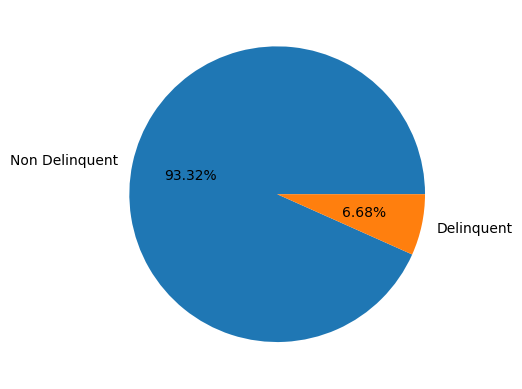

In [11]:
plt.pie(df["SeriousDlqin2yrs"].value_counts(),labels=['Non Delinquent','Delinquent'],autopct='%1.2f%%')
plt.show()

NOTE : DATA IS HIGHLY IMBALANCED

In [12]:
df.groupby(by='SeriousDlqin2yrs').median()

,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,,,,,,,,,,
0,0.133288,52.0,0.0,0.362659,5466.0,8.0,0.0,1.0,0.0,0.0
1,0.838853,45.0,0.0,0.428227,4500.0,7.0,0.0,1.0,0.0,0.0


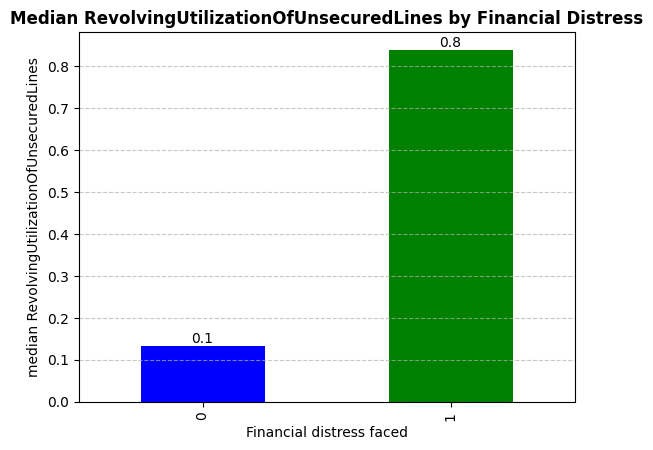

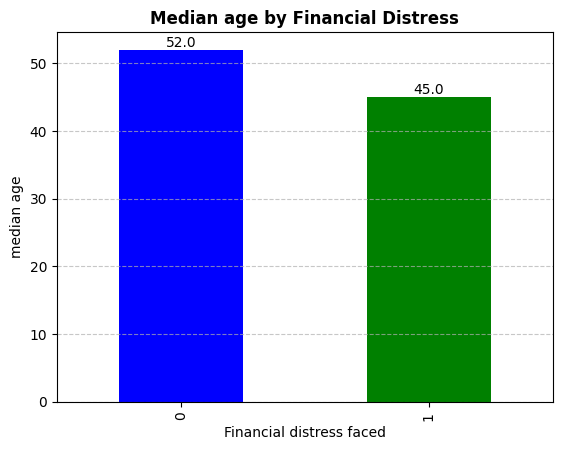

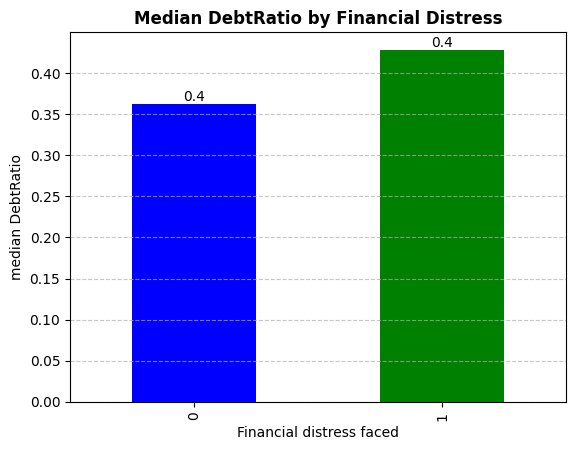

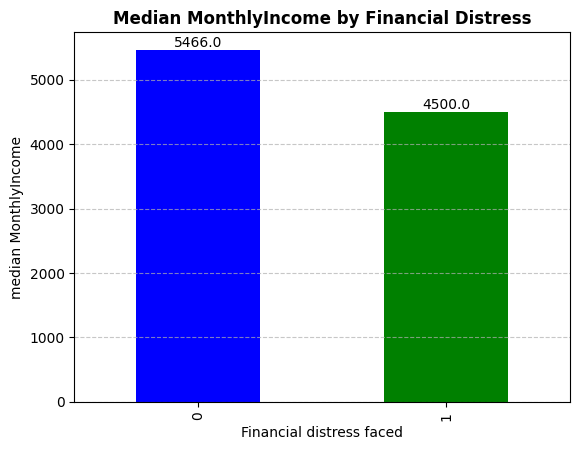

In [13]:
  for i in ['RevolvingUtilizationOfUnsecuredLines','age','DebtRatio','MonthlyIncome']:
        
        data = df.groupby('SeriousDlqin2yrs').median()[i]
        ax = data.plot(kind='bar', color=['blue', 'green'])
        for p in ax.patches:
            ax.annotate(f'{p.get_height():.1f}', (p.get_x() + p.get_width() / 2., p.get_height()),
                        ha='center', va='bottom')
        plt.xlabel("Financial distress faced")
        plt.ylabel(('median {}').format(i))
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.title(f'Median {i} by Financial Distress', fontsize=12, fontweight='bold')
        plt.show()



Comments:
- meadian debtratio of those who face financial ditress is higher compared to other category.   
- median age of person who face financial distress< than those who dont. We can conclude that yoounger people tend to default more. 
- median salary of those who faced financial distress > than those who dont.

In [14]:
cols= [i for i in df.columns if df[i].dtype=='float64']

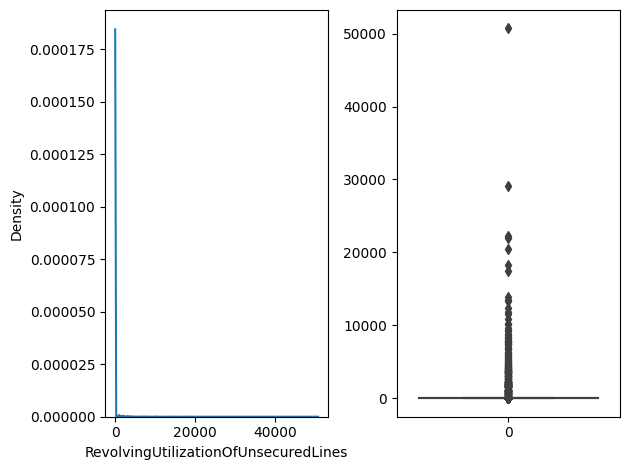

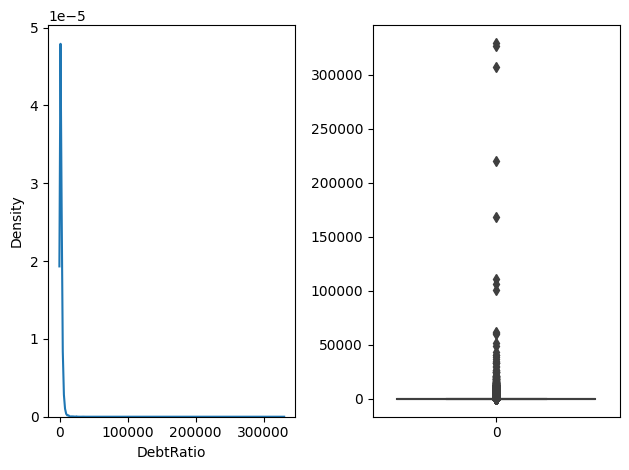

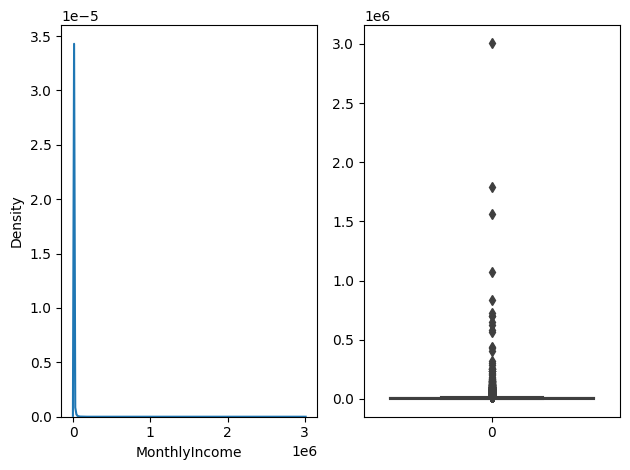

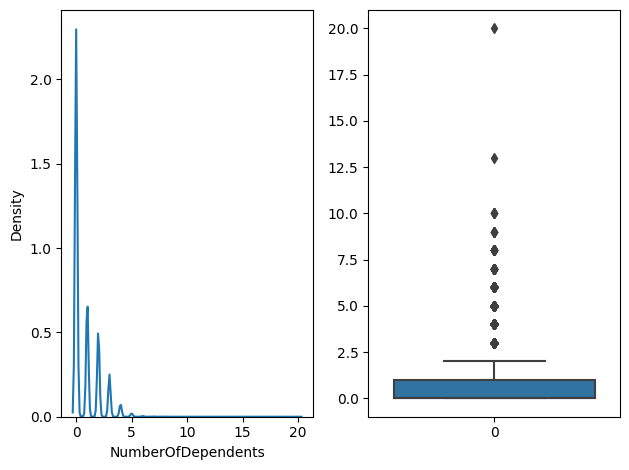

In [15]:
for i in cols:
    
    fig,(ax_kde,ax_box) =plt.subplots(nrows=1,ncols=2)
    sns.boxplot(df[i],ax=ax_box)
    sns.kdeplot(df[i], ax=ax_kde)
    plt.tight_layout()

In [16]:
# finding the upper and lower value beyond which the data value can be considered as outlier.
o_up = []
o_low = []
for name, values in df.iteritems():
    IQR1 = df[name].quantile(q=0.25)
    IQR3 = df[name].quantile(q=0.75)
    Outlier_value_Upper = IQR3 + (IQR3 - IQR1) * 1.5
    Outlier_value_lower = IQR1 - (IQR3 - IQR1) * 1.5
    
    o_up.append(Outlier_value_Upper)
    o_low.append(Outlier_value_lower)
    
outlier_df1 = pd.DataFrame({"Columns": df.columns, "Upper bound value": o_up, "Lower bound value": o_low})
outlier_df1.set_index('Columns', inplace=True)

outlier_df1


,Upper bound value,Lower bound value
Columns,,
SeriousDlqin2yrs,0.000000,0.000000
RevolvingUtilizationOfUnsecuredLines,1.352814,-0.763901
age,96.000000,8.000000
NumberOfTime30-59DaysPastDueNotWorse,0.000000,0.000000
DebtRatio,1.908024,-0.864696
MonthlyIncome,15522.500000,-3873.500000
NumberOfOpenCreditLinesAndLoans,20.000000,-4.000000
NumberOfTimes90DaysLate,0.000000,0.000000
NumberRealEstateLoansOrLines,5.000000,-3.000000


In [17]:
# FInding number of outliers in each column:
a = []
for name, values in df.iteritems():
    IQR1 = df[name].quantile(q=0.25)
    IQR3 = df[name].quantile(q=0.75)
    Outlier_value = IQR3 + (IQR3 - IQR1) * 1.5
    counts = df[df[name] > Outlier_value][name].count()
    a.append(counts)

p = pd.DataFrame({"Column name": df.columns, "Number of Outliers": a})
p['Percentage'] = round(((p['Number of Outliers'] / df.shape[0]) * 100),2)

print(p)


                             Column name  Number of Outliers  Percentage
0                       SeriousDlqin2yrs               10026        6.68
1   RevolvingUtilizationOfUnsecuredLines                 763        0.51
2                                    age                  45        0.03
3   NumberOfTime30-59DaysPastDueNotWorse               23982       15.99
4                              DebtRatio               31311       20.87
5                          MonthlyIncome                4879        3.25
6        NumberOfOpenCreditLinesAndLoans                3980        2.65
7                NumberOfTimes90DaysLate                8338        5.56
8           NumberRealEstateLoansOrLines                 793        0.53
9   NumberOfTime60-89DaysPastDueNotWorse                7604        5.07
10                    NumberOfDependents               13336        8.89


### Comments for strategy:

- imputing missing value can be done with random value from the same columns so as to maintain the distribution or we can use knn or iterative imputer or common values like mean,median etc but it will depend on whether the data is MCAR or not.
- for RevolvingUtilizationOfUnsecuredLines,age,numberrealestateloansorlines column's we can avoid any change as the number of outliers are quite less. 
- For others we can either keep all the outliers and try to observe the results in model or we replace the outlier's with the upper bound values or we can completely remove them.
- Number of outliers in DebtRatio and NumberOfTime30-59DaysPastDueNotWorse are very high.

#### 1.Substituting Nan Value:


In [18]:
df.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0


In [19]:
df['MonthlyincomeStatus']=np.NaN

In [20]:
for i in range(len(df)):
    if np.isnan(df.iloc[i]['MonthlyIncome']):
        df.loc[i, 'MonthlyincomeStatus'] = 1
    else:
        df.loc[i, 'MonthlyincomeStatus'] = 0

In [21]:
df.tail()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,MonthlyincomeStatus
149995,0,0.040674,74,0,0.225131,2100.0,4,0,1,0,0.0,0.0
149996,0,0.299745,44,0,0.716562,5584.0,4,0,1,0,2.0,0.0
149997,0,0.246044,58,0,3870.000000,NaN,18,0,1,0,0.0,1.0
149998,0,0.000000,30,0,0.000000,5716.0,4,0,0,0,0.0,0.0
149999,0,0.850283,64,0,0.249908,8158.0,8,0,2,0,0.0,0.0


In [22]:
data_crosstab = pd.crosstab(df['MonthlyincomeStatus'],
                            df['SeriousDlqin2yrs'], 
                               margins = False)

The data is not missing at random or we have evidence against the hypothesis that data is MCAR


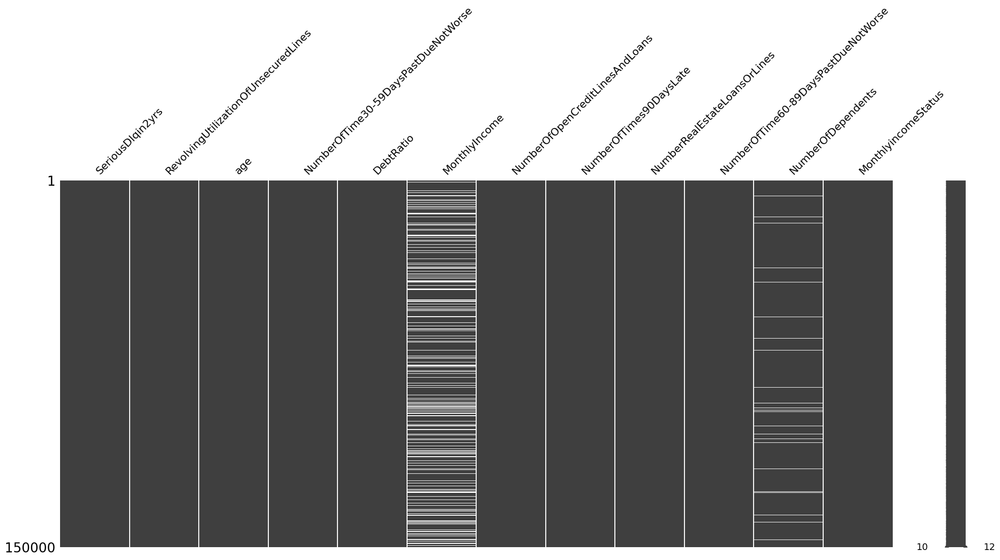

In [23]:
# Performing test to chekc if the data is MCAR 
import missingno as msno
from scipy.stats import chi2_contingency


msno.matrix(df)

chi2, p_value, _, _ = chi2_contingency(data_crosstab)

alpha = 0.05
if p_value <= alpha:
    print("The data is not missing at random or we have evidence against the hypothesis that data is MCAR")
else:
    print("The data is missing at random or we have evidence supporting that data is MCAR")


In [24]:
# Query : But according to definition we should check the relation with all the independent columns.

Comment: SInce data is not MCAR simple imputation techniques wont be a reliable in such scenarios . Advance imputation technique like KNN or Iterative imputer would be a better choice.

In [25]:
df.isnull().astype(int)

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,MonthlyincomeStatus
0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
149995,0,0,0,0,0,0,0,0,0,0,0,0
149996,0,0,0,0,0,0,0,0,0,0,0,0
149997,0,0,0,0,0,1,0,0,0,0,0,0
149998,0,0,0,0,0,0,0,0,0,0,0,0


In [26]:
missing_indicator = df.isnull().astype(int)

missing_corr = missing_indicator.corr()
missing_corr.abs()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,MonthlyincomeStatus
SeriousDlqin2yrs,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
RevolvingUtilizationOfUnsecuredLines,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
age,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfTime30-59DaysPastDueNotWorse,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
DebtRatio,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MonthlyIncome,NaN,NaN,NaN,NaN,NaN,1.000000,NaN,NaN,NaN,NaN,0.329646,NaN
NumberOfOpenCreditLinesAndLoans,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfTimes90DaysLate,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberRealEstateLoansOrLines,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NumberOfTime60-89DaysPastDueNotWorse,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [27]:
# Check if the data is MCAR
def is_mcar(df):
    missing_indicator = df.isnull().astype(int)
    missing_corr = missing_indicator.corr()

    tolerance = 0.20
    if (missing_corr.abs() < tolerance).all().all():
        return ('Data is not Missing Completely at Random')
    else:
        return 'Data is Not Missing at Random'

print(is_mcar(df))


Data is Not Missing at Random


- **Comment: It is confirmed that data is not missing Completely at random. Hence simple imputation techniques like using mean/median etc would not be a right approcah.**
- **We could create a new categorical column also with value 0 for available data and 1 for missing data which would help us to tackle thises missing data after imputation** 

Comment: We can filter out the data where we have missing values in any column and we can study the other features like age, salary,number of dependents etc. and can see if there is any specific pattern.

In [28]:
df.drop(columns= 'MonthlyincomeStatus',inplace=True)

In [29]:
df.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0


<hr style="border: 1px solid #000000;">


In [30]:
df[df['MonthlyIncome'].isnull()]

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
6,0,0.305682,57,0,5710.0,NaN,8,0,3,0,0.0
8,0,0.116951,27,0,46.0,NaN,2,0,0,0,NaN
16,0,0.061086,78,0,2058.0,NaN,10,0,2,0,0.0
32,0,0.083418,62,0,977.0,NaN,6,0,1,0,0.0
41,0,0.072898,81,0,75.0,NaN,7,0,0,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
149976,0,0.000627,76,0,60.0,NaN,5,0,0,0,0.0
149977,0,0.236450,29,0,349.0,NaN,3,0,0,0,0.0
149984,0,0.037548,84,0,25.0,NaN,5,0,0,0,0.0
149992,0,0.871976,50,0,4132.0,NaN,11,0,1,0,3.0


Observation from Data:
The rows where monthly income is NaN the value in Debtratio is abnormally high.
There is a possibility that the value of Debtratio and Monthly income are swapped.

A. PREDICTIVE ANALYSIS WORK for monthly income and debt ratio

Comment: 
- A debt ratio of greater than 1.0 or 100% means a company has more debt than assets.Hence value of debt ratio values > 10 doesnt makes sense for practical reasons. 
- Additionally a monthlyincome of<1160 USD/Month is not feasible as min wages declared by US govenment 7.25 USD/hour or 1160 USD/Month. For practical purpose taking min wage as 1100 USD/Month. (Assuming data is from US)

In [30]:
df1 = df.copy(deep=True)
df2= df.copy(deep=True)

In [31]:
df1.query('DebtRatio >10 & MonthlyIncome<1100')[['MonthlyIncome','DebtRatio']]

,MonthlyIncome,DebtRatio
14,0.0,477.00000
44,1.0,1687.50000
50,0.0,3095.00000
73,0.0,3162.00000
90,0.0,15466.00000
...,...,...
149646,0.0,1248.00000
149673,0.0,4123.00000
149882,1.0,714.50000
149950,0.0,1940.00000


In [32]:
df1.query('DebtRatio >10 & MonthlyIncome.isnull()')[['MonthlyIncome','DebtRatio']]

,MonthlyIncome,DebtRatio
6,NaN,5710.0
8,NaN,46.0
16,NaN,2058.0
32,NaN,977.0
41,NaN,75.0
...,...,...
149976,NaN,60.0
149977,NaN,349.0
149984,NaN,25.0
149992,NaN,4132.0


Note: Places where monthly income is NaN or where DebtRatio doesnt seems reasonable, it seems that at these places the monthly income is acutually swapped with debt ratio.   

In [33]:
# Confirming the above statement

In [34]:
list_nan = df2[df2['MonthlyIncome'].isnull()].index
k=list(list_nan.values)

In [35]:
# Since we are not sure whether values in debtratio column is flawless or not,also values in Number of columns are misssing
# hence that column in evaluation of values for monthly column. 
cols_to_include = [i for i in df2.columns if (i!='DebtRatio') & (i!='NumberOfDependents')]

In [36]:
df2_null_income_rows = df2[df2['MonthlyIncome'].isnull()][cols_to_include ]
df2_null_income_rows

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse
6,0,0.305682,57,0,NaN,8,0,3,0
8,0,0.116951,27,0,NaN,2,0,0,0
16,0,0.061086,78,0,NaN,10,0,2,0
32,0,0.083418,62,0,NaN,6,0,1,0
41,0,0.072898,81,0,NaN,7,0,0,0
...,...,...,...,...,...,...,...,...,...
149976,0,0.000627,76,0,NaN,5,0,0,0
149977,0,0.236450,29,0,NaN,3,0,0,0
149984,0,0.037548,84,0,NaN,5,0,0,0
149992,0,0.871976,50,0,NaN,11,0,1,0


In [37]:

df2_MonthlyIncome_notnull_for_training_sc_knn = df2[~df2['MonthlyIncome'].isnull()][cols_to_include]
df2_MonthlyIncome_notnull_for_training_sc_knn.head(2)

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse
0,1,0.766127,45,2,9120.0,13,0,6,0
1,0,0.957151,40,0,2600.0,4,0,0,0


Comment: To apply knn or iterative imputer we need to standadize the data as knn is distance based algorithm hence the features need to be on same scale.

In [38]:
# Since our dataset has outliers robustscaler is a better choice to scale the data.
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()
df2_MonthlyIncome_notnull_sc= scaler.fit_transform(df2_MonthlyIncome_notnull_for_training_sc_knn)

In [39]:
df2_MonthlyIncome_notnull_sc[0]

array([ 1.        ,  1.08175093, -0.28571429,  2.        ,  0.76716849,
        0.83333333,  0.        ,  2.5       ,  0.        ])

In [40]:
# Training knn on thr non null data 
from sklearn.impute import KNNImputer
knn=  KNNImputer(weights='distance')
knn.fit(df2_MonthlyIncome_notnull_sc)

KNNImputer(weights='distance')

In [41]:
df2_null_income_sc_transformed= scaler.transform(df2_null_income_rows)
df2_null_income_sc_transformed

array([[ 0.        ,  0.23588096,  0.28571429, ...,  0.        ,
         1.        ,  0.        ],
       [ 0.        , -0.11083336, -1.14285714, ...,  0.        ,
        -0.5       ,  0.        ],
       [ 0.        , -0.21346062,  1.28571429, ...,  0.        ,
         0.5       ,  0.        ],
       ...,
       [ 0.        , -0.25670166,  1.57142857, ...,  0.        ,
        -0.5       ,  0.        ],
       [ 0.        ,  1.27620399, -0.04761905, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.12632054,  0.33333333, ...,  0.        ,
         0.        ,  0.        ]])

In [42]:
df2_null_income_knn_transformed = knn.transform(df2_null_income_sc_transformed)

In [43]:
df2_null_income_knn_transformed

array([[ 0.        ,  0.23588096,  0.28571429, ...,  0.        ,
         1.        ,  0.        ],
       [ 0.        , -0.11083336, -1.14285714, ...,  0.        ,
        -0.5       ,  0.        ],
       [ 0.        , -0.21346062,  1.28571429, ...,  0.        ,
         0.5       ,  0.        ],
       ...,
       [ 0.        , -0.25670166,  1.57142857, ...,  0.        ,
        -0.5       ,  0.        ],
       [ 0.        ,  1.27620399, -0.04761905, ...,  0.        ,
         0.        ,  0.        ],
       [ 0.        ,  0.12632054,  0.33333333, ...,  0.        ,
         0.        ,  0.        ]])

In [44]:
# Inverse transforming the imputed data
df2_null_income_scale_data_transformed_after_knn = scaler.inverse_transform(df2_null_income_knn_transformed)
df2_null_income_scale_data_transformed_after_knn

array([[0.00000000e+00, 3.05682465e-01, 5.70000000e+01, ...,
        0.00000000e+00, 3.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 1.16950644e-01, 2.70000000e+01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 6.10861180e-02, 7.80000000e+01, ...,
        0.00000000e+00, 2.00000000e+00, 0.00000000e+00],
       ...,
       [0.00000000e+00, 3.75481230e-02, 8.40000000e+01, ...,
        0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 8.71975945e-01, 5.00000000e+01, ...,
        0.00000000e+00, 1.00000000e+00, 0.00000000e+00],
       [0.00000000e+00, 2.46043918e-01, 5.80000000e+01, ...,
        0.00000000e+00, 1.00000000e+00, 0.00000000e+00]])

In [45]:
df_transformed =pd.DataFrame(df2_null_income_scale_data_transformed_after_knn,columns=df2_null_income_rows.columns,index=k)

In [46]:
df_transformed

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse
6,0.0,0.305682,57.0,0.0,15697.036856,8.0,0.0,3.0,0.0
8,0.0,0.116951,27.0,0.0,3844.563042,2.0,0.0,0.0,0.0
16,0.0,0.061086,78.0,0.0,8250.925947,10.0,0.0,2.0,0.0
32,0.0,0.083418,62.0,0.0,9168.923830,6.0,0.0,1.0,0.0
41,0.0,0.072898,81.0,0.0,4952.977150,7.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...
149976,0.0,0.000627,76.0,0.0,3862.888061,5.0,0.0,0.0,0.0
149977,0.0,0.236450,29.0,0.0,3165.781774,3.0,0.0,0.0,0.0
149984,0.0,0.037548,84.0,0.0,3200.672192,5.0,0.0,0.0,0.0
149992,0.0,0.871976,50.0,0.0,6186.462961,11.0,0.0,1.0,0.0


In [47]:
list1=df.iloc[k]['DebtRatio']
list1=list1.reset_index(drop=True)
list1

0        5710.0
1          46.0
2        2058.0
3         977.0
4          75.0
          ...  
29726      60.0
29727     349.0
29728      25.0
29729    4132.0
29730    3870.0
Name: DebtRatio, Length: 29731, dtype: float64

In [48]:
list2= df_transformed['MonthlyIncome']
list2=list2.reset_index(drop=True)
list2

0        15697.036856
1         3844.563042
2         8250.925947
3         9168.923830
4         4952.977150
             ...     
29726     3862.888061
29727     3165.781774
29728     3200.672192
29729     6186.462961
29730     4997.842313
Name: MonthlyIncome, Length: 29731, dtype: float64

In [49]:
absolute_diff = pd.Series([(abs(x - y)/(y+1))*100 for x, y in zip(df_transformed['MonthlyIncome'], df.iloc[k]['DebtRatio'])])
absolute_diff

0          174.873697
1         8082.049026
2          300.773480
3          837.620024
4         6418.390987
             ...     
29726     6234.242724
29727      804.794793
29728    12214.123816
29729       49.708758
29730       29.135684
Length: 29731, dtype: float64

In [50]:
(absolute_diff<15).value_counts()

False    29087
True       644
dtype: int64

**Comment:From above we can conclude that the data is not swapped between Monthly income and Debtratio column.**


**********************************************************************************************************************

In [51]:
#Replacing NumberOfDependents column Nan values with random value from the same column so that the kde plot is not affected much
#df1['NumberOfDependents'][df1['NumberOfDependents'].isnull()] = df1['NumberOfDependents'].dropna().sample(df1.NumberOfDependents.isnull().sum()).values

In [52]:
# # swapping Nan values of MonthlyIncome with numerical value of DebtRatio column given DebtRatio> 10 
# nan_condition = df1['MonthlyIncome'].isnull() & ~df1['DebtRatio'].isnull() & (df1['DebtRatio'] > 10)
# df1.loc[nan_condition, ['MonthlyIncome', 'DebtRatio']] = df1.loc[nan_condition, ['DebtRatio', 'MonthlyIncome']].values

In [53]:
# # swapping values of both the table where DebtRatio > 10 and MonthlyIncome <5
# df1.loc[(df1['DebtRatio'] >= 10) & (df1['MonthlyIncome'] <= 5), ['DebtRatio', 'MonthlyIncome']] = df1.loc[(df['DebtRatio'] >= 10) & (df1['MonthlyIncome'] <= 5), ['MonthlyIncome', 'DebtRatio']].values

#### <mark>Imputing missing values in Monthly Income column and data points where debt ratio is >5 replacing it with NaN and then imputing it.</mark>

In [31]:
df.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0


In [32]:
df_for_imputation =df.copy()

In [33]:
# where ever Debt Ratio >5  I am substituting that with NaN and then later on we can fill these Nan value with a suitable one.
indx = df_for_imputation[df_for_imputation['DebtRatio']>5].index
df_for_imputation.loc[indx,'DebtRatio'] =np.NaN

In [34]:
df_for_imputation[df_for_imputation['DebtRatio']>5]['DebtRatio']

Series([], Name: DebtRatio, dtype: float64)

In [35]:
#!pip install fancyimputer

In [36]:
# using iterative imputer to fill up the values
from fancyimpute import IterativeImputer


# Perform Multiple Imputation using MICE
imputer = IterativeImputer(max_iter=10, random_state=0)

# Fit and transform the DataFrame to impute missing values
imputed_data = imputer.fit_transform(df_for_imputation)

# Convert the imputed data back to a DataFrame
df_imputed_using_iterativeimputer = pd.DataFrame(imputed_data, columns=df_for_imputation.columns)

df_imputed_using_iterativeimputer


,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1.0,0.766127,45.0,2.0,0.802982,9120.000000,13.0,0.0,6.0,0.0,2.0
1,0.0,0.957151,40.0,0.0,0.121876,2600.000000,4.0,0.0,0.0,0.0,1.0
2,0.0,0.658180,38.0,1.0,0.085113,3042.000000,2.0,1.0,0.0,0.0,0.0
3,0.0,0.233810,30.0,0.0,0.036050,3300.000000,5.0,0.0,0.0,0.0,0.0
4,0.0,0.907239,49.0,1.0,0.024926,63588.000000,7.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
149995,0.0,0.040674,74.0,0.0,0.225131,2100.000000,4.0,0.0,1.0,0.0,0.0
149996,0.0,0.299745,44.0,0.0,0.716562,5584.000000,4.0,0.0,1.0,0.0,2.0
149997,0.0,0.246044,58.0,0.0,0.426823,7303.913806,18.0,0.0,1.0,0.0,0.0
149998,0.0,0.000000,30.0,0.0,0.000000,5716.000000,4.0,0.0,0.0,0.0,0.0


In [37]:
df_imputed_using_iterativeimputer.isnull().sum()

SeriousDlqin2yrs                        0
RevolvingUtilizationOfUnsecuredLines    0
age                                     0
NumberOfTime30-59DaysPastDueNotWorse    0
DebtRatio                               0
MonthlyIncome                           0
NumberOfOpenCreditLinesAndLoans         0
NumberOfTimes90DaysLate                 0
NumberRealEstateLoansOrLines            0
NumberOfTime60-89DaysPastDueNotWorse    0
NumberOfDependents                      0
dtype: int64

In [38]:
# FInding current number of outliers in each column after data imputation:
a = []
for name, values in df_imputed_using_iterativeimputer.iteritems():
    IQR1 = df_imputed_using_iterativeimputer[name].quantile(q=0.25)
    IQR3 = df_imputed_using_iterativeimputer[name].quantile(q=0.75)
    Outlier_value = IQR3 + (IQR3 - IQR1) * 1.5
    counts = df_imputed_using_iterativeimputer[df_imputed_using_iterativeimputer[name] > Outlier_value][name].count()
    a.append(counts)

p = pd.DataFrame({"Column name": df_imputed_using_iterativeimputer.columns, "Number of Outliers": a})
p['Percentage'] = (p['Number of Outliers'] / df_imputed_using_iterativeimputer.shape[0]) * 100

print(p)


                             Column name  Number of Outliers  Percentage
0                       SeriousDlqin2yrs               10026    6.684000
1   RevolvingUtilizationOfUnsecuredLines                 763    0.508667
2                                    age                  45    0.030000
3   NumberOfTime30-59DaysPastDueNotWorse               23982   15.988000
4                              DebtRatio                7669    5.112667
5                          MonthlyIncome                6733    4.488667
6        NumberOfOpenCreditLinesAndLoans                3980    2.653333
7                NumberOfTimes90DaysLate                8338    5.558667
8           NumberRealEstateLoansOrLines                 793    0.528667
9   NumberOfTime60-89DaysPastDueNotWorse                7604    5.069333
10                    NumberOfDependents               13336    8.890667


Comment: There is drastic decrease in outlier number in Debt ratio.

Comment: Instead of iterative imputer we could have used KNN but since knn is sensitive 'number of neighbours value' using iteratiev imputer will be a good choice. Although iterative imputer is a bit computationally expensive but predictions are good. 

In [62]:
# from sklearn.impute import KNNImputer
# from sklearn.preprocessing import StandardScaler

In [63]:
# sc=StandardScaler()
# df_sc= sc.fit_transform(df1)

In [64]:
# knn=  KNNImputer(weights='distance')
# df1_knn= knn.fit_transform(df_sc)

In [65]:
# # Inverse transforming the imputed data
# original_scale_data = sc.inverse_transform(df1_knn)
# original_scale_data

In [66]:
# df_after_nan=pd.DataFrame(original_scale_data,columns=df1.columns)
# df_after_nan.head(10)

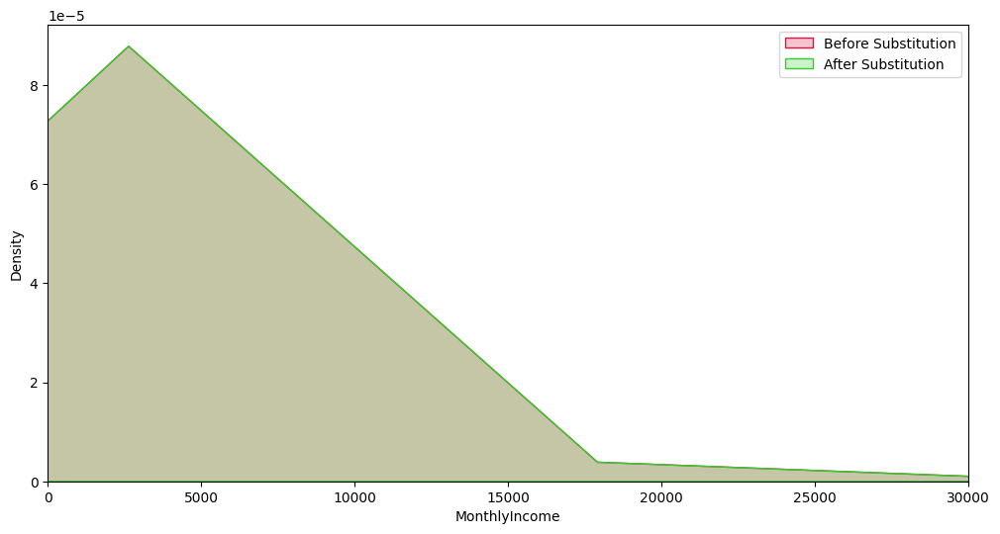

In [40]:
fig, ax = plt.subplots(figsize=(12, 6))
sns.kdeplot(data=df_imputed_using_iterativeimputer['MonthlyIncome'],
            color='crimson', label='Before Substitution', fill=True, ax=ax)
sns.kdeplot(data=df_imputed_using_iterativeimputer['MonthlyIncome'],
            color='limegreen', label='After Substitution', fill=True, ax=ax)
ax.legend()
ax.set_xlim([0.0,30000])
plt.show()


**No Major** change in KDE plot.Hence **accepting** this approach.

In [41]:
df_imputed_using_iterativeimputer['NumberOfDependents']=df_imputed_using_iterativeimputer['NumberOfDependents'].round()

In [42]:
(df['NumberOfDependents'].value_counts().reset_index()).merge(df_imputed_using_iterativeimputer['NumberOfDependents'].value_counts().reset_index(),left_index=True,right_index=True)

,index_x,NumberOfDependents_x,index_y,NumberOfDependents_y
0,0.0,86902,0.0,88706
1,1.0,26316,1.0,28427
2,2.0,19522,2.0,19527
3,3.0,9483,3.0,9483
4,4.0,2862,4.0,2862
5,5.0,746,5.0,746
6,6.0,158,6.0,158
7,7.0,51,7.0,51
8,8.0,24,8.0,24
9,10.0,5,10.0,5


In [43]:
df_imputed_using_iterativeimputer['NumberOfDependents'] = df_imputed_using_iterativeimputer['NumberOfDependents'].replace(-1, 13)

In [44]:
print(df_imputed_using_iterativeimputer['NumberOfDependents'].value_counts())

0.0     88706
1.0     28427
2.0     19527
3.0      9483
4.0      2862
5.0       746
6.0       158
7.0        51
8.0        24
10.0        5
13.0        5
9.0         5
20.0        1
Name: NumberOfDependents, dtype: int64


In [45]:
(df['NumberOfDependents'].value_counts().reset_index()).merge(df_imputed_using_iterativeimputer['NumberOfDependents'].value_counts().reset_index(),left_index=True,right_index=True)

,index_x,NumberOfDependents_x,index_y,NumberOfDependents_y
0,0.0,86902,0.0,88706
1,1.0,26316,1.0,28427
2,2.0,19522,2.0,19527
3,3.0,9483,3.0,9483
4,4.0,2862,4.0,2862
5,5.0,746,5.0,746
6,6.0,158,6.0,158
7,7.0,51,7.0,51
8,8.0,24,8.0,24
9,10.0,5,10.0,5


In [46]:
df_imputed_using_iterativeimputer.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,1.500000e+05,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000
mean,0.066840,6.048438,52.295207,0.421033,0.369722,6.454770e+03,8.452760,0.265973,1.018240,0.240387,0.751900
std,0.249746,249.755371,14.771866,4.192781,0.399130,1.298195e+04,5.145951,4.169304,1.129771,4.155179,1.105728
min,0.000000,0.000000,0.000000,0.000000,-0.036197,-2.432680e+04,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.029867,41.000000,0.000000,0.174611,3.700000e+03,5.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.154181,52.000000,0.000000,0.308744,5.500000e+03,8.000000,0.000000,1.000000,0.000000,0.000000
75%,0.000000,0.559046,63.000000,0.000000,0.458847,7.849473e+03,11.000000,0.000000,2.000000,0.000000,1.000000
max,1.000000,50708.000000,109.000000,98.000000,6.774315,3.008750e+06,58.000000,98.000000,54.000000,98.000000,20.000000


In [48]:
# negative debt ratio is considered extremely risky. A negative ratio is generally an indicator of bankruptcy

###### DATAFRAME TO BE USED AFTER IMPUTATION: df_imputed_using_iterativeimputer

#### <mark>Strategies to handle Outliers:</mark>
- Replacing the Outlier values with the upper bound value from 5 point Summary data.(lower bound not selected as lower bound is negative) also few columns need to be ommited as there upper bound value is 0.
- Removing the outliers completely.
- keeping outliers as it is in dataset.

<b> A.</b> Creating a dataframe where the the outliers will be replaced.

In [49]:
df1=df.copy()

In [50]:
df1

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
149995,0,0.040674,74,0,0.225131,2100.0,4,0,1,0,0.0
149996,0,0.299745,44,0,0.716562,5584.0,4,0,1,0,2.0
149997,0,0.246044,58,0,3870.000000,NaN,18,0,1,0,0.0
149998,0,0.000000,30,0,0.000000,5716.0,4,0,0,0,0.0


In [51]:
df_outlier_replaced= pd.DataFrame()

In [52]:
# finding the upper and lower value beyond which the data value can be considered as outlier.
o_up = []
o_low = []
for name, values in df_imputed_using_iterativeimputer.iteritems():
    IQR1 = df_imputed_using_iterativeimputer[name].quantile(q=0.25)
    IQR3 = df_imputed_using_iterativeimputer[name].quantile(q=0.75)
    Outlier_value_Upper = IQR3 + (IQR3 - IQR1) * 1.5
    Outlier_value_lower = IQR1 - (IQR3 - IQR1) * 1.5
    
    o_up.append(Outlier_value_Upper)
    o_low.append(Outlier_value_lower)
    
outlier_df = pd.DataFrame({"Columns": df_imputed_using_iterativeimputer.columns, "Upper bound value": o_up, "Lower bound value": o_low})
outlier_df.set_index('Columns', inplace=True)

outlier_df

,Upper bound value,Lower bound value
Columns,,
SeriousDlqin2yrs,0.000000,0.000000
RevolvingUtilizationOfUnsecuredLines,1.352814,-0.763901
age,96.000000,8.000000
NumberOfTime30-59DaysPastDueNotWorse,0.000000,0.000000
DebtRatio,0.885201,-0.251744
MonthlyIncome,14073.681421,-2524.208853
NumberOfOpenCreditLinesAndLoans,20.000000,-4.000000
NumberOfTimes90DaysLate,0.000000,0.000000
NumberRealEstateLoansOrLines,5.000000,-3.000000


In [53]:
#substituting all the outlier values with the upper bound value for each column except list 1 as their upper bound value came to be 0
list1= ['SeriousDlqin2yrs','NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate','NumberOfTime60-89DaysPastDueNotWorse',]
for col in df_imputed_using_iterativeimputer.drop(columns =list1):
     df_outlier_replaced[col] = np.where(df_imputed_using_iterativeimputer[col]>outlier_df.loc[col,'Upper bound value'],outlier_df.loc[col,'Upper bound value'],df_imputed_using_iterativeimputer[col])
df_outlier_replaced  

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents
0,0.766127,45.0,0.802982,9120.000000,13.0,5.0,2.0
1,0.957151,40.0,0.121876,2600.000000,4.0,0.0,1.0
2,0.658180,38.0,0.085113,3042.000000,2.0,0.0,0.0
3,0.233810,30.0,0.036050,3300.000000,5.0,0.0,0.0
4,0.907239,49.0,0.024926,14073.681421,7.0,1.0,0.0
...,...,...,...,...,...,...,...
149995,0.040674,74.0,0.225131,2100.000000,4.0,1.0,0.0
149996,0.299745,44.0,0.716562,5584.000000,4.0,1.0,2.0
149997,0.246044,58.0,0.426823,7303.913806,18.0,1.0,0.0
149998,0.000000,30.0,0.000000,5716.000000,4.0,0.0,0.0


In [54]:
#merging list1 columns back to dataframe
list2= ['NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate','NumberOfTime60-89DaysPastDueNotWorse']
df_imputed_outlier_replaced= pd.merge(df_outlier_replaced,df_imputed_using_iterativeimputer[list2],left_index=True,right_index= True)
df_imputed_outlier_replaced

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTimes90DaysLate,NumberOfTime60-89DaysPastDueNotWorse
0,0.766127,45.0,0.802982,9120.000000,13.0,5.0,2.0,2.0,0.0,0.0
1,0.957151,40.0,0.121876,2600.000000,4.0,0.0,1.0,0.0,0.0,0.0
2,0.658180,38.0,0.085113,3042.000000,2.0,0.0,0.0,1.0,1.0,0.0
3,0.233810,30.0,0.036050,3300.000000,5.0,0.0,0.0,0.0,0.0,0.0
4,0.907239,49.0,0.024926,14073.681421,7.0,1.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...
149995,0.040674,74.0,0.225131,2100.000000,4.0,1.0,0.0,0.0,0.0,0.0
149996,0.299745,44.0,0.716562,5584.000000,4.0,1.0,2.0,0.0,0.0,0.0
149997,0.246044,58.0,0.426823,7303.913806,18.0,1.0,0.0,0.0,0.0,0.0
149998,0.000000,30.0,0.000000,5716.000000,4.0,0.0,0.0,0.0,0.0,0.0


In [55]:
df_imputed_outlier_replaced.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 10 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 1   age                                   150000 non-null  float64
 2   DebtRatio                             150000 non-null  float64
 3   MonthlyIncome                         150000 non-null  float64
 4   NumberOfOpenCreditLinesAndLoans       150000 non-null  float64
 5   NumberRealEstateLoansOrLines          150000 non-null  float64
 6   NumberOfDependents                    150000 non-null  float64
 7   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  float64
 8   NumberOfTimes90DaysLate               150000 non-null  float64
 9   NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  float64
dtypes: float64(10)
memory usage: 11.4 MB


In [56]:
df_imputed_outlier_replaced.describe()

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,NumberOfTime30-59DaysPastDueNotWorse,NumberOfTimes90DaysLate,NumberOfTime60-89DaysPastDueNotWorse
count,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000,150000.000000
mean,0.322261,52.294167,0.334300,5986.285935,8.327833,1.002480,0.672207,0.421033,0.265973,0.240387
std,0.356572,14.768565,0.230837,3568.508882,4.736680,1.020301,0.902336,4.192781,4.169304,4.155179
min,0.000000,0.000000,-0.036197,-24326.798496,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.029867,41.000000,0.174611,3700.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,0.154181,52.000000,0.308744,5500.000000,8.000000,1.000000,0.000000,0.000000,0.000000,0.000000
75%,0.559046,63.000000,0.458847,7849.472568,11.000000,2.000000,1.000000,0.000000,0.000000,0.000000
max,1.352814,96.000000,0.885201,14073.681421,20.000000,5.000000,2.500000,98.000000,98.000000,98.000000


<mark><b>B.</b></mark> **Dropping rows which have outliers:** 

In [57]:
df_for_No_outliers_df= df_imputed_using_iterativeimputer.copy(deep=True)

In [58]:
outlier_df

,Upper bound value,Lower bound value
Columns,,
SeriousDlqin2yrs,0.000000,0.000000
RevolvingUtilizationOfUnsecuredLines,1.352814,-0.763901
age,96.000000,8.000000
NumberOfTime30-59DaysPastDueNotWorse,0.000000,0.000000
DebtRatio,0.885201,-0.251744
MonthlyIncome,14073.681421,-2524.208853
NumberOfOpenCreditLinesAndLoans,20.000000,-4.000000
NumberOfTimes90DaysLate,0.000000,0.000000
NumberRealEstateLoansOrLines,5.000000,-3.000000


In [59]:
list1= ['SeriousDlqin2yrs','NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate','NumberOfTime60-89DaysPastDueNotWorse',]
for col in df_imputed_using_iterativeimputer.drop(columns =list1):
     df_for_No_outliers_df[col] = np.where(df_imputed_using_iterativeimputer[col]>outlier_df.loc[col,'Upper bound value'],np.NaN,df_imputed_using_iterativeimputer[col])
df_for_No_outliers_df  

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1.0,0.766127,45.0,2.0,0.802982,9120.000000,13.0,0.0,NaN,0.0,2.0
1,0.0,0.957151,40.0,0.0,0.121876,2600.000000,4.0,0.0,0.0,0.0,1.0
2,0.0,0.658180,38.0,1.0,0.085113,3042.000000,2.0,1.0,0.0,0.0,0.0
3,0.0,0.233810,30.0,0.0,0.036050,3300.000000,5.0,0.0,0.0,0.0,0.0
4,0.0,0.907239,49.0,1.0,0.024926,NaN,7.0,0.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
149995,0.0,0.040674,74.0,0.0,0.225131,2100.000000,4.0,0.0,1.0,0.0,0.0
149996,0.0,0.299745,44.0,0.0,0.716562,5584.000000,4.0,0.0,1.0,0.0,2.0
149997,0.0,0.246044,58.0,0.0,0.426823,7303.913806,18.0,0.0,1.0,0.0,0.0
149998,0.0,0.000000,30.0,0.0,0.000000,5716.000000,4.0,0.0,0.0,0.0,0.0


In [60]:
df_for_No_outliers_df.dropna(inplace=True)

In [61]:
df_without_outliers=df_for_No_outliers_df.copy(deep=True)

In [62]:
df_without_outliers.describe()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
count,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000,120569.000000
mean,0.061177,0.310449,52.702370,0.438089,0.301731,5655.331673,7.777530,0.298460,0.879579,0.272475,0.479700
std,0.239655,0.351745,15.327748,4.598571,0.197670,2789.858399,4.329525,4.580888,0.918249,4.569345,0.723964
min,0.000000,0.000000,0.000000,0.000000,-0.036197,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.026801,41.000000,0.000000,0.161003,3701.000000,5.000000,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.137725,53.000000,0.000000,0.290642,5350.000000,7.000000,0.000000,1.000000,0.000000,0.000000
75%,0.000000,0.535171,63.000000,0.000000,0.424066,7271.000000,10.000000,0.000000,1.000000,0.000000,1.000000
max,1.000000,1.352159,96.000000,98.000000,0.885173,14073.000000,20.000000,98.000000,5.000000,98.000000,2.000000


## <mark>Statistical Analysis</mark>

##### considering dataset df_imputed_using_iterativeimputer where we have just imputed the missing values.

<mark>CHecking if the data is normal distributed or not in columns having continuous numerical data.</mark> Since parametric statistical tests, such as t-tests, ANOVA, linear regression, and others, assume that the data is normally distributed so to check this is essential.

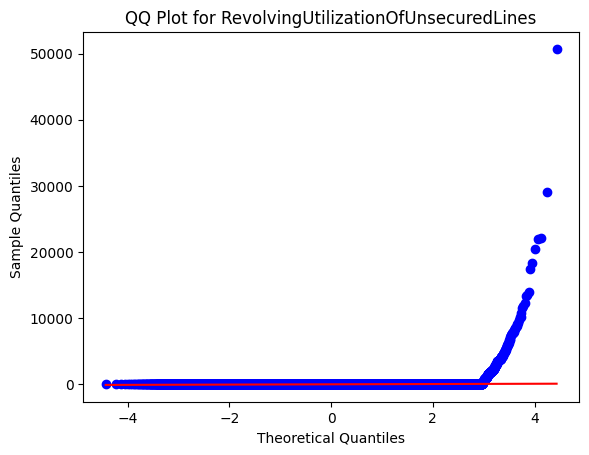

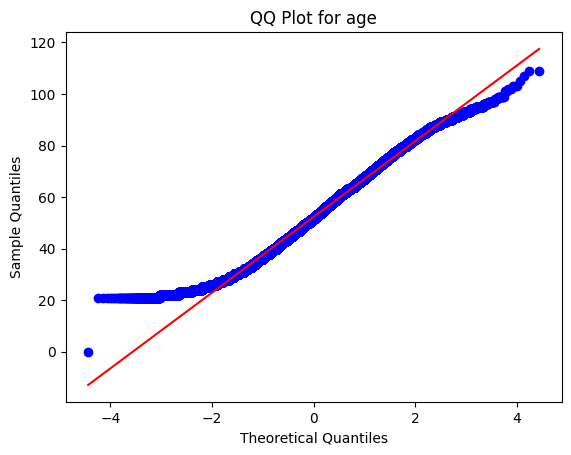

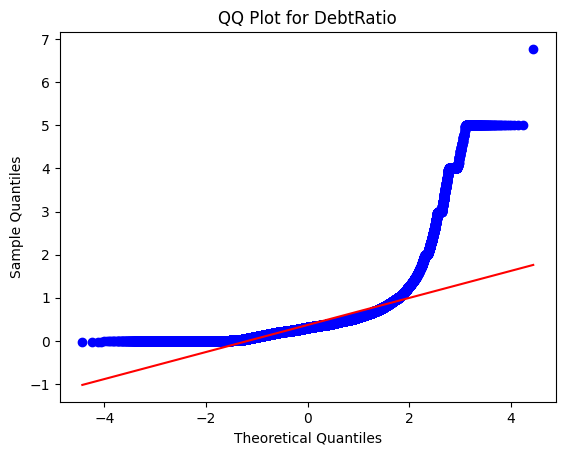

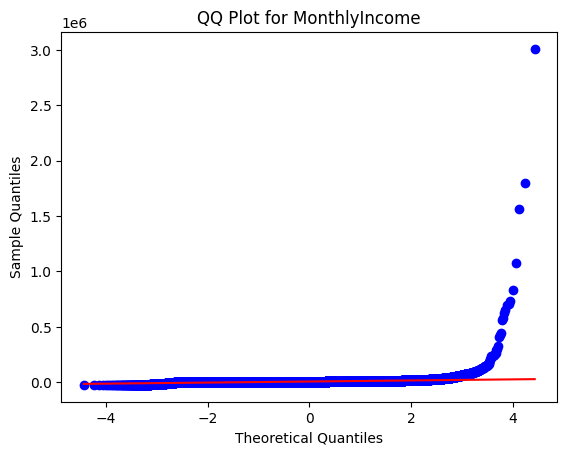

In [89]:
import scipy.stats as stats

col_list=['RevolvingUtilizationOfUnsecuredLines','age','DebtRatio','MonthlyIncome']
for i in col_list:
    # Generate the QQ plot
    res = stats.probplot(df_imputed_using_iterativeimputer[i], plot=plt)

    # Set plot labels
    plt.xlabel('Theoretical Quantiles')
    plt.ylabel('Sample Quantiles')
    plt.title('QQ Plot for {}'.format(i))

    plt.show()


In [90]:
#confirming the above results staistically:
col_list=['RevolvingUtilizationOfUnsecuredLines','age','DebtRatio','MonthlyIncome']
for column in col_list:
        data = df_imputed_using_iterativeimputer[column]
        
        # Perform Shapiro-Wilk test
        _, p_value = stats.shapiro(data)
        alpha = 0.05  # significance level
        
        if p_value > alpha:
            print(f"Column '{column}' follows a normal distribution (p-value: {p_value:.4f})")
        else:
            print(f"Column '{column}' does not follow a normal distribution (p-value: {p_value:.4f})")
        

Column 'RevolvingUtilizationOfUnsecuredLines' does not follow a normal distribution (p-value: 0.0000)
Column 'age' does not follow a normal distribution (p-value: 0.0000)
Column 'DebtRatio' does not follow a normal distribution (p-value: 0.0000)
Column 'MonthlyIncome' does not follow a normal distribution (p-value: 0.0000)


Comment: We are 95% confident that the data in columns age,debtratio,monthlyincome and RevolvingUtilizationOfUnsecuredLines are not normally distributed.

#### A. The average MonthlyIncome of borrowers who have experienced serious delinquency in the past 90 days is significantly different from those who have not.

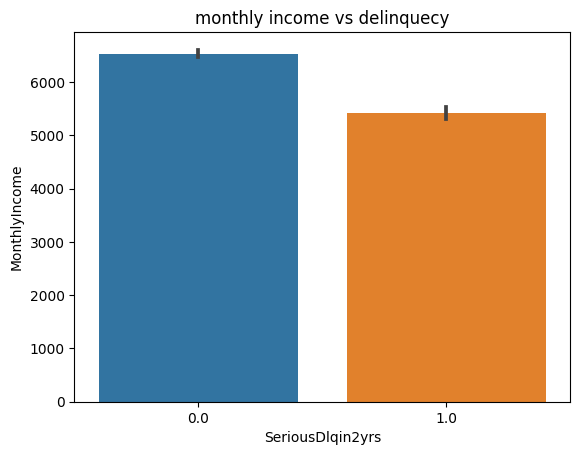

In [91]:
sns.barplot(data=df_imputed_using_iterativeimputer,x='SeriousDlqin2yrs',y='MonthlyIncome')
plt.title("monthly income vs delinquecy")
plt.show()

In [92]:
from scipy import stats
data = df_imputed_using_iterativeimputer['MonthlyIncome'].values

transformed_data, optimal_lambda = stats.yeojohnson(data)

# Create a new column in the DataFrame to store the transformed data
df_imputed_using_iterativeimputer['transformed_MonthlyIncome'] = transformed_data

In [93]:
from scipy.stats import ttest_ind

In [94]:
exp_delinquency  = df_imputed_using_iterativeimputer[df_imputed_using_iterativeimputer['SeriousDlqin2yrs']==1]['transformed_MonthlyIncome']

In [95]:
dn_exp_delinquency =  df_imputed_using_iterativeimputer[df_imputed_using_iterativeimputer['SeriousDlqin2yrs']==0]['transformed_MonthlyIncome']

In [96]:
ttest_ind(exp_delinquency,dn_exp_delinquency,equal_var=False)


Ttest_indResult(statistic=-14.448105766047446, pvalue=5.292960809885316e-47)

- since pvalue < 0.05 we have strong reason to reject the null hypothesis and we can say with proof that The average MonthlyIncome of borrowers who have experienced serious delinquency in the past 90 days is significantly different from those who have not.

-  this means that borrowers who have experienced serious delinquency in the past 90 days tend to have a significantly lower average MonthlyIncome compared to borrowers who have not

#### B.Does the number of dependents have a significant impact on the likelihood of serious delinquency in the past 90 days? Also how an increase in number of dependents affect likelihood of serious delinquecy

In [97]:
df_imputed_using_iterativeimputer['NumberOfDependents'].value_counts()

0.0     88706
1.0     28427
2.0     19527
3.0      9483
4.0      2862
5.0       746
6.0       158
7.0        51
8.0        24
10.0        5
13.0        5
9.0         5
20.0        1
Name: NumberOfDependents, dtype: int64

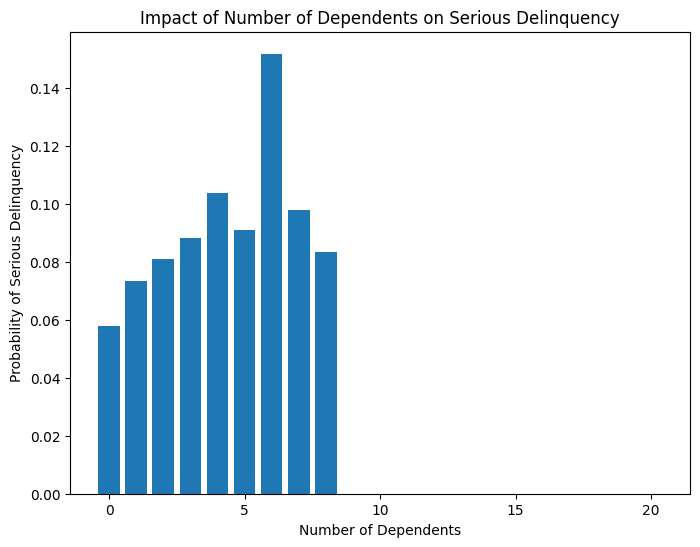

In [98]:
grouped_data = df_imputed_using_iterativeimputer.groupby('NumberOfDependents')['SeriousDlqin2yrs'].mean().reset_index()

plt.figure(figsize=(8, 6))
plt.bar(grouped_data['NumberOfDependents'], grouped_data['SeriousDlqin2yrs'])
plt.xlabel('Number of Dependents')
plt.ylabel('Probability of Serious Delinquency')
plt.title('Impact of Number of Dependents on Serious Delinquency')
plt.show()

From the sample it is evident that as the number of dpendents increase chance of Serious Delinquency increases considerably.

In [99]:
from scipy.stats import chi2_contingency

In [100]:
contigency_tab=pd.crosstab(df_imputed_using_iterativeimputer['NumberOfDependents'],df_imputed_using_iterativeimputer['SeriousDlqin2yrs'])
contigency_tab

SeriousDlqin2yrs,0.0,1.0
NumberOfDependents,,
0.0,83585,5121
1.0,26340,2087
2.0,17942,1585
3.0,8646,837
4.0,2565,297
5.0,678,68
6.0,134,24
7.0,46,5
8.0,22,2


In [101]:
chi2_contingency(contigency_tab)

Chi2ContingencyResult(statistic=361.84071591935924, pvalue=4.4426776648722866e-70, dof=12, expected_freq=array([[8.27768910e+04, 5.92910904e+03],
       [2.65269393e+04, 1.90006068e+03],
       [1.82218153e+04, 1.30518468e+03],
       [8.84915628e+03, 6.33843720e+02],
       [2.67070392e+03, 1.91296080e+02],
       [6.96137360e+02, 4.98626400e+01],
       [1.47439280e+02, 1.05607200e+01],
       [4.75911600e+01, 3.40884000e+00],
       [2.23958400e+01, 1.60416000e+00],
       [4.66580000e+00, 3.34200000e-01],
       [4.66580000e+00, 3.34200000e-01],
       [4.66580000e+00, 3.34200000e-01],
       [9.33160000e-01, 6.68400000e-02]]))

Comments:
- There is a violation of assumption here that the expected frequency value should be atleast 5

In [102]:
# to understand the strength and nature of relationship
chi2, p_value, d_f, arr = chi2_contingency(contigency_tab)
n = contigency_tab.sum().sum()
phi_coefficient = np.sqrt(chi2 / n)
cramers_v = phi_coefficient / np.sqrt(min(contigency_tab.shape) - 1)

print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("P-value:", p_value)
print("Cramer's V:", cramers_v)

Chi-square test results:
Chi-square statistic: 361.84071591935924
P-value: 4.4426776648722866e-70
Cramer's V: 0.04911488002084903


**Based on these results, we can conclude that although there is a relationship between the "NumberOfDependents" variable and the likelihood of serious delinquency but the Cramers value suggest a weak relationship.**

In [103]:
# # checking if the linearity assumption of logistic regression holds true or not.
# import statsmodels.api as sm
# X = sm.add_constant(df_after_nan['NumberOfDependents'])  # Add constant term
# y = np.array(df1['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
# model = sm.Logit(y, X)
# result = model.fit()

# # Obtain predicted probabilities
# pred_probs = result.predict(X)
# #The probabilities obtained above is for each row indicating the likelihood (probability) of that individual 
# #facing serious delinquency based on the logistic regression model.

# # Plot the predicted log odds against the predictor
# plt.scatter(df_after_nan['NumberOfDependents'], np.log(pred_probs / (1 - pred_probs)))
# plt.xlabel('Predictor (x)')
# plt.ylabel('Predicted log odds')
# plt.title('Linearity of Predictors and Log Odds')
# plt.show()


In [104]:
# #considering NumberOfDependents to be a continuous variable 
# import statsmodels.api as sm
# X = df_after_nan['NumberOfDependents']
# y = df1['SeriousDlqin2yrs']

# X = sm.add_constant(X)

# logit_model = sm.Logit(y, X)
# result = logit_model.fit()

# print(result.summary())

In [105]:
# odds_ratio= math.exp(0.1526)
# odds_ratio

In [106]:
# # Calcuating base prabbalities
# num_delinquent = len(df_after_nan[df_after_nan['SeriousDlqin2yrs'] == 1])
# total_count = len(df_after_nan)
# baseline_probability = num_delinquent / total_count
# print("Baseline Probability:", baseline_probability)

In [107]:
# odds= odds_ratio * baseline_probability
# odds

In [108]:
# prob = odds/(1+odds)
# prob

Comment : 
- positive value of coeff signifies that there is a positive relation between the two variable i.e. an increase in number of dependents leads to increase in chance of serious delinquecy.
- a unit increase in number of dependent leads to 7.22% increase in probability of serious delinquecy.

#### C. There is a correlation between the number of real estate loans or lines of credit and the likelihood of serious delinquency.

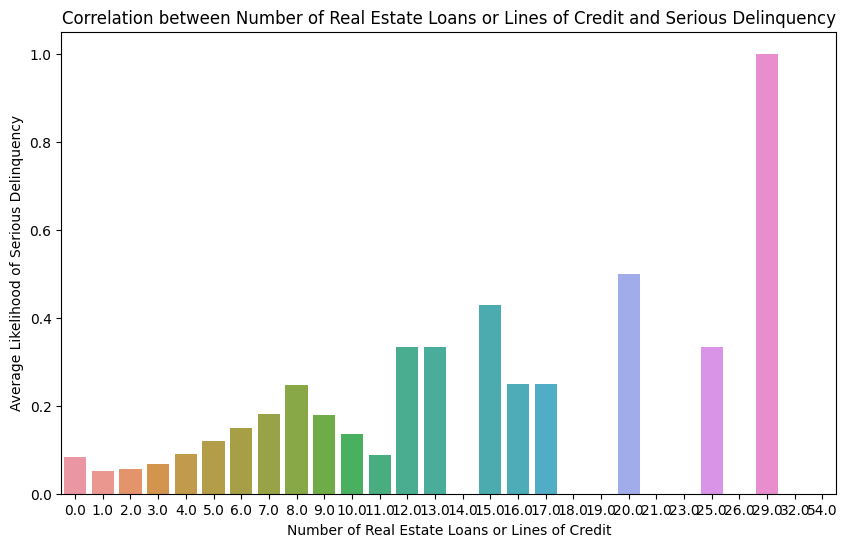

In [109]:
grouped_data = df_imputed_using_iterativeimputer.groupby('NumberRealEstateLoansOrLines')['SeriousDlqin2yrs'].mean()

plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y=grouped_data.values)
plt.xlabel('Number of Real Estate Loans or Lines of Credit')
plt.ylabel('Average Likelihood of Serious Delinquency')
plt.title('Correlation between Number of Real Estate Loans or Lines of Credit and Serious Delinquency')
plt.show()


In [110]:
#considering NumberRealEstateLoansOrLines column as categorical
contigency_tab_realestate =pd.crosstab(df_imputed_using_iterativeimputer['NumberRealEstateLoansOrLines'],df_imputed_using_iterativeimputer['SeriousDlqin2yrs'])
contigency_tab_realestate

SeriousDlqin2yrs,0.0,1.0
NumberRealEstateLoansOrLines,,
0.0,51516,4672
1.0,49590,2748
2.0,29757,1765
3.0,5878,422
4.0,1976,194
5.0,606,83
6.0,272,48
7.0,140,31
8.0,70,23


In [111]:
chi2_contingency(contigency_tab_realestate)

Chi2ContingencyResult(statistic=740.912294239074, pvalue=1.0089756541467085e-138, dof=27, expected_freq=array([[5.24323941e+04, 3.75560592e+03],
       [4.88397281e+04, 3.49827192e+03],
       [2.94150695e+04, 2.10693048e+03],
       [5.87890800e+03, 4.21092000e+02],
       [2.02495720e+03, 1.45042800e+02],
       [6.42947240e+02, 4.60527600e+01],
       [2.98611200e+02, 2.13888000e+01],
       [1.59570360e+02, 1.14296400e+01],
       [8.67838800e+01, 6.21612000e+00],
       [7.27864800e+01, 5.21352000e+00],
       [3.45269200e+01, 2.47308000e+00],
       [2.14626800e+01, 1.53732000e+00],
       [1.67968800e+01, 1.20312000e+00],
       [1.39974000e+01, 1.00260000e+00],
       [6.53212000e+00, 4.67880000e-01],
       [6.53212000e+00, 4.67880000e-01],
       [3.73264000e+00, 2.67360000e-01],
       [3.73264000e+00, 2.67360000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [9.33160000e-01, 6.68400000e

In [112]:
# to understand the strength and nature of relationship
chi2, p_value, d_f, arr = chi2_contingency(contigency_tab_realestate)
n = contigency_tab_realestate.sum().sum()
phi_coefficient = np.sqrt(chi2 / n)
cramers_v = phi_coefficient / np.sqrt(min(contigency_tab_realestate.shape) - 1)

print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("P-value:", p_value)
print("Cramer's V:", cramers_v)

Chi-square test results:
Chi-square statistic: 740.912294239074
P-value: 1.0089756541467085e-138
Cramer's V: 0.07028097391845932


**Comment: Although there is a relationship between variable and the likelihood of serious delinquency but the Cramers value suggest a weak relationship**

In [113]:
# # checking if the linearity assumption of logistic regression holds true or not.
# import statsmodels.api as sm
# X = sm.add_constant(df_after_nan['NumberRealEstateLoansOrLines'])  # Add constant term
# y = np.array(df1['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
# model = sm.Logit(y, X)
# result = model.fit()

# # Obtain predicted probabilities
# pred_probs = result.predict(X)
# #The probabilities obtained above is for each row indicating the likelihood (probability) of that individual 
# #facing serious delinquency based on the logistic regression model.

# # Plot the predicted log odds against the predictor
# plt.scatter(df_after_nan['NumberRealEstateLoansOrLines'], np.log(pred_probs / (1 - pred_probs)))
# plt.xlabel('Predictor (x)')
# plt.ylabel('Predicted log odds')
# plt.title('Linearity of Predictors and Log Odds')
# plt.show()

In [114]:
# #considering it to be a continuous variable

# import statsmodels.api as sm
# X = df_after_nan['NumberRealEstateLoansOrLines']
# y = df1['SeriousDlqin2yrs']

# X = sm.add_constant(X)

# logit_model = sm.Logit(y, X)
# result = logit_model.fit()

# print(result.summary())

In [115]:
# odds_ratio= math.exp(-0.0260)
# odds= odds_ratio * baseline_probability
# prob = odds/(1+odds)
# prob


Comment : 
- negative value of coeff signifies that there is a negative relation between the two variable i.e. an increase in leads to decrease in chance of serious delinquecy.
- a unit increase in NumberRealEstateLoansOrLines leads to 6.11% increase in probability of serious delinquecy.

#### D.Borrowers with a higher debt ratio to monthly income have a higher probability of serious delinquency.

In [116]:
df_imputed_using_iterativeimputer['db/income'] = df_imputed_using_iterativeimputer['DebtRatio']/(df_imputed_using_iterativeimputer['MonthlyIncome']+1)
df_imputed_using_iterativeimputer['db/income']

0         8.803663e-05
1         4.685744e-05
2         2.797022e-05
3         1.092084e-05
4         3.919812e-07
              ...     
149995    1.071542e-04
149996    1.283012e-04
149997    5.842957e-05
149998    0.000000e+00
149999    3.062974e-05
Name: db/income, Length: 150000, dtype: float64

In [117]:
from sklearn.linear_model import LogisticRegression
lg = LogisticRegression()

Optimization terminated successfully.
         Current function value: 0.244493
         Iterations 7


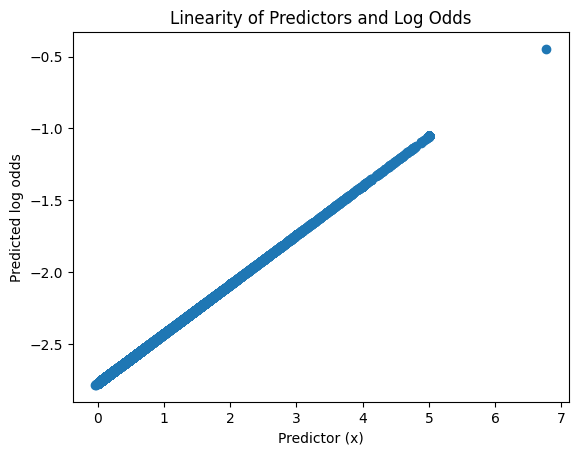

In [118]:
# checking if the linearity assumption of logistic regression holds true or not.
import statsmodels.api as sm
X = sm.add_constant(df_imputed_using_iterativeimputer['DebtRatio'])  # Add constant term
y = np.array(df['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
model = sm.Logit(y, X)
result = model.fit()

# Obtain predicted probabilities
pred_probs = result.predict(X)
#The probabilities obtained above is for each row indicating the likelihood (probability) of that individual 
#facing serious delinquency based on the logistic regression model.

# Plot the predicted log odds against the predictor
plt.scatter(df_imputed_using_iterativeimputer['DebtRatio'], np.log(pred_probs / (1 - pred_probs)))
plt.xlabel('Predictor (x)')
plt.ylabel('Predicted log odds')
plt.title('Linearity of Predictors and Log Odds')
plt.show()

Optimization terminated successfully.
         Current function value: 0.244024
         Iterations 7


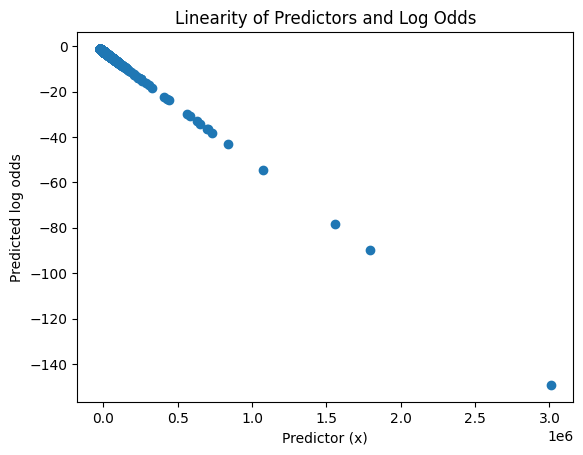

In [119]:
# checking if the linearity assumption of logistic regression holds true or not.
import statsmodels.api as sm
X = sm.add_constant(df_imputed_using_iterativeimputer['MonthlyIncome'])  # Add constant term
y = np.array(df['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
model = sm.Logit(y, X)
result = model.fit()

# Obtain predicted probabilities
pred_probs = result.predict(X)
#The probabilities obtained above is for each row indicating the likelihood (probability) of that individual 
#facing serious delinquency based on the logistic regression model.

# Plot the predicted log odds against the predictor
plt.scatter(df_imputed_using_iterativeimputer['MonthlyIncome'], np.log(pred_probs / (1 - pred_probs)))
plt.xlabel('Predictor (x)')
plt.ylabel('Predicted log odds')
plt.title('Linearity of Predictors and Log Odds')
plt.show()

Optimization terminated successfully.
         Current function value: 0.245340
         Iterations 8


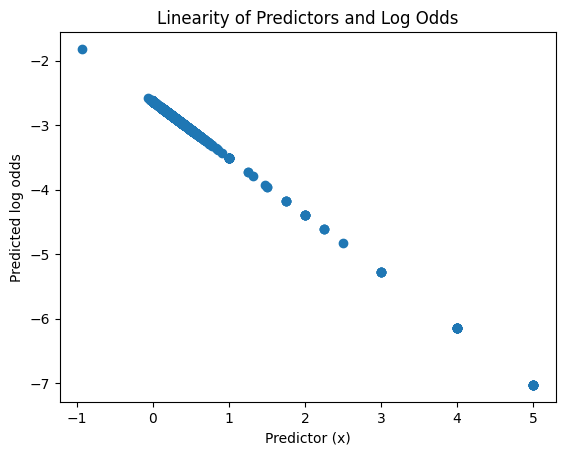

In [120]:
# checking if the linearity assumption of logistic regression holds true or not.
import statsmodels.api as sm
X = sm.add_constant(df_imputed_using_iterativeimputer['db/income'])  # Add constant term
y = np.array(df['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
model = sm.Logit(y, X)
result = model.fit()

# Obtain predicted probabilities
pred_probs = result.predict(X)
#The probabilities obtained above is for each row indicating the likelihood (probability) of that individual 
#facing serious delinquency based on the logistic regression model.

# Plot the predicted log odds against the predictor
plt.scatter(df_imputed_using_iterativeimputer['db/income'], np.log(pred_probs / (1 - pred_probs)))
plt.xlabel('Predictor (x)')
plt.ylabel('Predicted log odds')
plt.title('Linearity of Predictors and Log Odds')
plt.show()

In [121]:
#considering it to be a continuous variable

import statsmodels.api as sm
X = df_imputed_using_iterativeimputer['db/income']
y = df['SeriousDlqin2yrs']

X = sm.add_constant(X)

logit_model = sm.Logit(y, X)
result = logit_model.fit()

print(result.summary())

Optimization terminated successfully.
         Current function value: 0.245340
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:       SeriousDlqin2yrs   No. Observations:               150000
Model:                          Logit   Df Residuals:                   149998
Method:                           MLE   Df Model:                            1
Date:                Sat, 19 Aug 2023   Pseudo R-squ.:               0.0001939
Time:                        20:45:39   Log-Likelihood:                -36801.
converged:                       True   LL-Null:                       -36808.
Covariance Type:            nonrobust   LLR p-value:                 0.0001579
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.6325      0.010   -253.519      0.000      -2.653      -2.612
db/income     -0.8793      0.

In [122]:
result.params[1]

-0.8792808629860492

In [123]:
odds_ratio_debtmonthly= math.exp(result.params[1])
odds_ratio_debtmonthly

0.41508130470600046

In [124]:
#comment:

In [125]:
# Calcuating base prabbalities
num_delinquent = len(df_imputed_using_iterativeimputer[df['SeriousDlqin2yrs'] == 1])
total_count = len(df_imputed_using_iterativeimputer)
baseline_probability = num_delinquent / total_count
print("Baseline Probability:", baseline_probability)

Baseline Probability: 0.06684


In [126]:
odds_debtmonthly= odds_ratio_debtmonthly * baseline_probability
prob = odds_debtmonthly/(1+odds_debtmonthly)
prob

0.02699508192481927

Comment :
- The negative sign of coeff says as the debt ratio to monthly income increases, the log-odds of serious delinquency decrease i.e. borrowers with a higher debt ratio to monthly income are less likely to experience serious delinquency.
-  for every one-unit increase in the debt ratio to monthly income, the odds of serious delinquency decrease by about 0.879 times or for each unit increase in the debt ratio to monthly income value, the probability of serious delinquency decreases by approximately 2.699% 
- Results are unusual.


#### E. Is there a relationship between the number of times a borrower has been past due in the last 2 years and the likelihood of serious delinquency.

In [127]:
df_imputed_using_iterativeimputer['pastdue'] = df_imputed_using_iterativeimputer['NumberOfTime60-89DaysPastDueNotWorse']+df_imputed_using_iterativeimputer['NumberOfTime30-59DaysPastDueNotWorse']
df_imputed_using_iterativeimputer['pastdue']

0         2.0
1         0.0
2         1.0
3         0.0
4         1.0
         ... 
149995    0.0
149996    0.0
149997    0.0
149998    0.0
149999    0.0
Name: pastdue, Length: 150000, dtype: float64

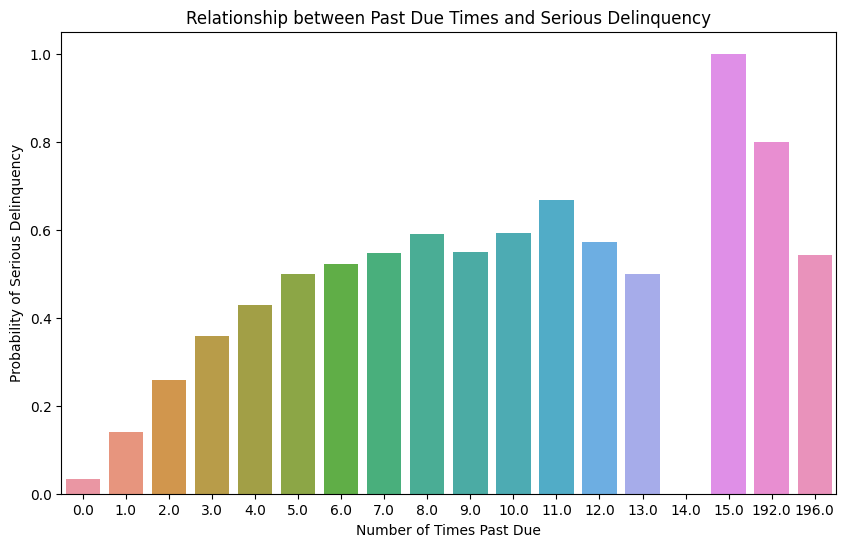

In [128]:
grouped_data = df_imputed_using_iterativeimputer.groupby('pastdue')['SeriousDlqin2yrs'].mean()

plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y=grouped_data.values)
plt.xlabel('Number of Times Past Due')
plt.ylabel('Probability of Serious Delinquency')
plt.title('Relationship between Past Due Times and Serious Delinquency')
plt.show()

Comment :
To some extent we can infer as the "number of times past due in the last 2 year" increases the chances of serious delinquecy increases. 

In [129]:
df_imputed_using_iterativeimputer.head(1)

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,transformed_MonthlyIncome,db/income,pastdue
0,1.0,0.766127,45.0,2.0,0.802982,9120.0,13.0,0.0,6.0,0.0,2.0,4621.973212,0.000088,2.0


In [130]:
chi2_table_pastdue= pd.crosstab(df_imputed_using_iterativeimputer['pastdue'],df_imputed_using_iterativeimputer['SeriousDlqin2yrs'])
chi2_table_pastdue

SeriousDlqin2yrs,0.0,1.0
pastdue,,
0.0,118629,4178
1.0,14520,2360
2.0,3977,1381
3.0,1502,842
4.0,638,478
5.0,295,294
6.0,152,166
7.0,77,93
8.0,27,39


In [131]:
from scipy.stats import chi2_contingency
chi2_contingency(chi2_table_pastdue)

Chi2ContingencyResult(statistic=17339.429070193044, pvalue=0.0, dof=17, expected_freq=array([[1.14598580e+05, 8.20841988e+03],
       [1.57517408e+04, 1.12825920e+03],
       [4.99987128e+03, 3.58128720e+02],
       [2.18732704e+03, 1.56672960e+02],
       [1.04140656e+03, 7.45934400e+01],
       [5.49631240e+02, 3.93687600e+01],
       [2.96744880e+02, 2.12551200e+01],
       [1.58637200e+02, 1.13628000e+01],
       [6.15885600e+01, 4.41144000e+00],
       [2.89279600e+01, 2.07204000e+00],
       [2.51953200e+01, 1.80468000e+00],
       [1.11979200e+01, 8.02080000e-01],
       [6.53212000e+00, 4.67880000e-01],
       [3.73264000e+00, 2.67360000e-01],
       [9.33160000e-01, 6.68400000e-02],
       [9.33160000e-01, 6.68400000e-02],
       [4.66580000e+00, 3.34200000e-01],
       [2.46354240e+02, 1.76457600e+01]]))

In [132]:
chi2, p_value, d_f, arr = chi2_contingency(chi2_table_pastdue)
n = chi2_table_pastdue.sum().sum()
phi_coefficient = np.sqrt(chi2 / n)
cramers_v = phi_coefficient / np.sqrt(min(chi2_table_pastdue.shape) - 1)

print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("P-value:", p_value)
print("Cramer's V:", cramers_v)

Chi-square test results:
Chi-square statistic: 17339.429070193044
P-value: 0.0
Cramer's V: 0.3399944026028766


**Based on these results, we can conclude that there is a significant relationship between the two columns**

In [133]:
# to understand the strength and nature of relationship
chi2, p_value, df, arr = chi2_contingency(chi2_table_pastdue)
n = chi2_table_pastdue.sum().sum()
phi_coefficient = np.sqrt(chi2 / n)
cramers_v = phi_coefficient / np.sqrt(min(chi2_table_pastdue.shape) - 1)

print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("P-value:", p_value)
print("Cramer's V:", cramers_v)

Chi-square test results:
Chi-square statistic: 17339.429070193044
P-value: 0.0
Cramer's V: 0.3399944026028766


Comment:
Cramer's V value of: 0.3399944026028766 indicates moderate strength. 

In [134]:
df_imputed_using_iterativeimputer.drop('pastdue',axis=1,inplace=True)

In [135]:
df_imputed_using_iterativeimputer.drop(columns=['transformed_MonthlyIncome','db/income'],axis=1,inplace=True)

#### F.Age plays a significant role in determining the likelihood of serious delinquency.

In [136]:
age_grouped = df_imputed_using_iterativeimputer.groupby('age')['SeriousDlqin2yrs'].mean()
age_grouped.values

array([0.        , 0.07103825, 0.08294931, 0.10920437, 0.12009804,
       0.12696747, 0.12321878, 0.12406577, 0.13141026, 0.10517039,
       0.10789881, 0.10647694, 0.11365854, 0.10987048, 0.0974478 ,
       0.10730187, 0.09962169, 0.09004363, 0.08931965, 0.09373954,
       0.08535403, 0.0941704 , 0.09377028, 0.08603491, 0.07346691,
       0.08109652, 0.08723748, 0.08228018, 0.07514451, 0.08157415,
       0.07434053, 0.07526882, 0.07675256, 0.07236842, 0.06852008,
       0.06440281, 0.05767623, 0.05422222, 0.04763288, 0.05091463,
       0.04604052, 0.04968768, 0.04568386, 0.03656897, 0.03073905,
       0.03546646, 0.03207698, 0.03156213, 0.02058166, 0.01791198,
       0.0292628 , 0.0255164 , 0.02789569, 0.02763158, 0.02687802,
       0.01772764, 0.0202874 , 0.01637853, 0.0227704 , 0.0224261 ,
       0.0216895 , 0.01162791, 0.02936631, 0.01953125, 0.01666667,
       0.01863354, 0.01474201, 0.02240896, 0.02555911, 0.0326087 ,
       0.01515152, 0.03246753, 0.        , 0.01149425, 0.02127

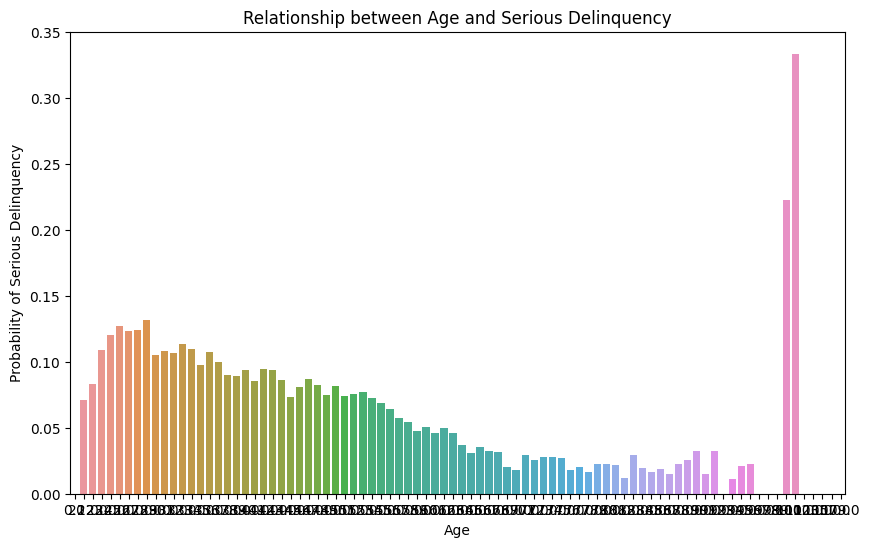

In [137]:
age_grouped = df_imputed_using_iterativeimputer.groupby('age')['SeriousDlqin2yrs'].mean()

plt.figure(figsize=(10, 6))
sns.barplot(x=age_grouped.index, y= age_grouped.values)
plt.xlabel('Age')
plt.ylabel('Probability of Serious Delinquency')
plt.title('Relationship between Age and Serious Delinquency')
plt.show()

In [138]:
import statsmodels.api as sm
from statsmodels.formula.api import ols

In [139]:
model = ols('age ~ SeriousDlqin2yrs', data=df_imputed_using_iterativeimputer).fit()

In [140]:
anova_table = sm.stats.anova_lm(model, typ=2)

In [141]:
print(anova_table)

                        sum_sq        df            F  PR(>F)
SeriousDlqin2yrs  4.357744e+05       1.0  2023.993129     0.0
Residual          3.229521e+07  149998.0          NaN     NaN


**Since p(F)=0  there are significant differences between the groups in terms of the "SeriousDlqin2yrs" variable.**

**G. Is there any significant differences in the likelihood of serious delinquency based on the number of real estate loans or lines of credit they have**

In [142]:
df_imputed_using_iterativeimputer.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1.0,0.766127,45.0,2.0,0.802982,9120.0,13.0,0.0,6.0,0.0,2.0
1,0.0,0.957151,40.0,0.0,0.121876,2600.0,4.0,0.0,0.0,0.0,1.0
2,0.0,0.658180,38.0,1.0,0.085113,3042.0,2.0,1.0,0.0,0.0,0.0
3,0.0,0.233810,30.0,0.0,0.036050,3300.0,5.0,0.0,0.0,0.0,0.0
4,0.0,0.907239,49.0,1.0,0.024926,63588.0,7.0,0.0,1.0,0.0,0.0


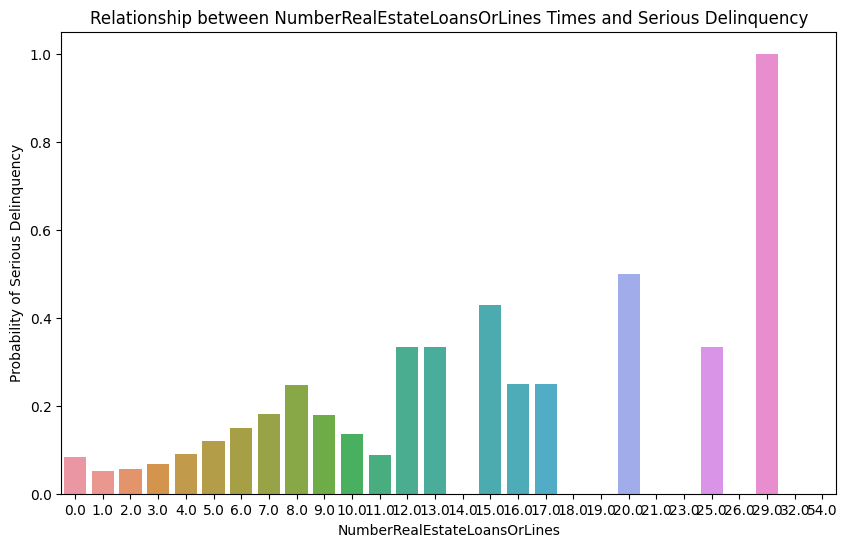

In [143]:
grouped_data = df_imputed_using_iterativeimputer.groupby('NumberRealEstateLoansOrLines')['SeriousDlqin2yrs'].mean()

plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y=grouped_data.values)
plt.xlabel('NumberRealEstateLoansOrLines')
plt.ylabel('Probability of Serious Delinquency')
plt.title('Relationship between NumberRealEstateLoansOrLines Times and Serious Delinquency')
plt.show()

In [144]:
chi2_table_NumberRealEstateLoansOrLines= pd.crosstab(df_imputed_using_iterativeimputer['NumberRealEstateLoansOrLines'],df_imputed_using_iterativeimputer['SeriousDlqin2yrs'])
chi2_table_NumberRealEstateLoansOrLines

SeriousDlqin2yrs,0.0,1.0
NumberRealEstateLoansOrLines,,
0.0,51516,4672
1.0,49590,2748
2.0,29757,1765
3.0,5878,422
4.0,1976,194
5.0,606,83
6.0,272,48
7.0,140,31
8.0,70,23


In [145]:
chi2_contingency(chi2_table_NumberRealEstateLoansOrLines)

Chi2ContingencyResult(statistic=740.912294239074, pvalue=1.0089756541467085e-138, dof=27, expected_freq=array([[5.24323941e+04, 3.75560592e+03],
       [4.88397281e+04, 3.49827192e+03],
       [2.94150695e+04, 2.10693048e+03],
       [5.87890800e+03, 4.21092000e+02],
       [2.02495720e+03, 1.45042800e+02],
       [6.42947240e+02, 4.60527600e+01],
       [2.98611200e+02, 2.13888000e+01],
       [1.59570360e+02, 1.14296400e+01],
       [8.67838800e+01, 6.21612000e+00],
       [7.27864800e+01, 5.21352000e+00],
       [3.45269200e+01, 2.47308000e+00],
       [2.14626800e+01, 1.53732000e+00],
       [1.67968800e+01, 1.20312000e+00],
       [1.39974000e+01, 1.00260000e+00],
       [6.53212000e+00, 4.67880000e-01],
       [6.53212000e+00, 4.67880000e-01],
       [3.73264000e+00, 2.67360000e-01],
       [3.73264000e+00, 2.67360000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [1.86632000e+00, 1.33680000e-01],
       [9.33160000e-01, 6.68400000e

In [146]:
chi2, p_value, d_f, arr = chi2_contingency(chi2_table_NumberRealEstateLoansOrLines)
n = chi2_table_NumberRealEstateLoansOrLines.sum().sum()
phi_coefficient = np.sqrt(chi2 / n)
cramers_v = phi_coefficient / np.sqrt(min(chi2_table_NumberRealEstateLoansOrLines.shape) - 1)

print("Chi-square test results:")
print("Chi-square statistic:", chi2)
print("P-value:", p_value)
print("Cramer's V:", cramers_v)

Chi-square test results:
Chi-square statistic: 740.912294239074
P-value: 1.0089756541467085e-138
Cramer's V: 0.07028097391845932


**Comment: There is a relationship between the two feature but strngth is very moderate.**

**H.What kind of relationship does the revolving utilization of unsecured lines have with the probability of serious delinquency?**

In [147]:
df_imputed_using_iterativeimputer.columns

Index(['SeriousDlqin2yrs', 'RevolvingUtilizationOfUnsecuredLines', 'age',
       'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio', 'MonthlyIncome',
       'NumberOfOpenCreditLinesAndLoans', 'NumberOfTimes90DaysLate',
       'NumberRealEstateLoansOrLines', 'NumberOfTime60-89DaysPastDueNotWorse',
       'NumberOfDependents'],
      dtype='object')

In [148]:


X = df_imputed_using_iterativeimputer['RevolvingUtilizationOfUnsecuredLines']
y = df1['SeriousDlqin2yrs']

X = sm.add_constant(X)

logit_model = sm.Logit(y, X)
result = logit_model.fit()

print(result.summary())

Optimization terminated successfully.
         Current function value: 0.245385
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:       SeriousDlqin2yrs   No. Observations:               150000
Model:                          Logit   Df Residuals:                   149998
Method:                           MLE   Df Model:                            1
Date:                Sat, 19 Aug 2023   Pseudo R-squ.:               8.408e-06
Time:                        20:45:44   Log-Likelihood:                -36808.
converged:                       True   LL-Null:                       -36808.
Covariance Type:            nonrobust   LLR p-value:                    0.4314
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -2.6361      0.0

Optimization terminated successfully.
         Current function value: 0.245385
         Iterations 7


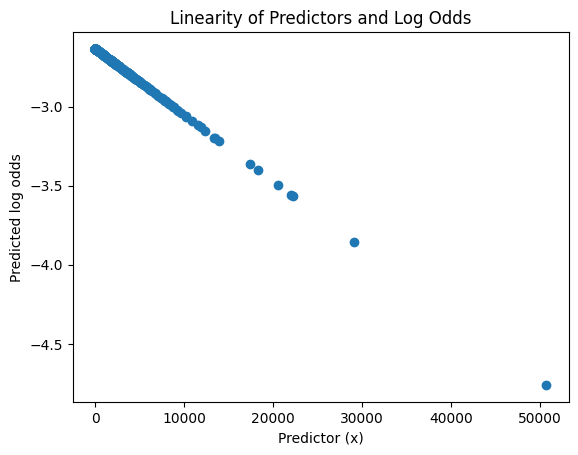

In [149]:
# checking if the linearity assumption of logistic regression holds true or not.
import statsmodels.api as sm
X = sm.add_constant(df_imputed_using_iterativeimputer['RevolvingUtilizationOfUnsecuredLines'])  # Add constant term
y = np.array(df1['SeriousDlqin2yrs']).astype(float) # Logit function requires the dependent variable to be an array-like object.
model = sm.Logit(y, X)
result = model.fit()

# Obtain predicted probabilities
pred_probs = result.predict(X)

# Plot the predicted log odds against the predictor
plt.scatter(df_imputed_using_iterativeimputer['RevolvingUtilizationOfUnsecuredLines'], np.log(pred_probs / (1 - pred_probs)))
plt.xlabel('Predictor (x)')
plt.ylabel('Predicted log odds')
plt.title('Linearity of Predictors and Log Odds')
plt.show()

In [150]:
X = df_imputed_using_iterativeimputer['RevolvingUtilizationOfUnsecuredLines']
y = df1['SeriousDlqin2yrs']

X_poly = sm.add_constant(np.column_stack((X, X**2))) 
logit_model_poly = sm.Logit(y, X_poly)
result_poly = logit_model_poly.fit()

print(result_poly.summary())


Optimization terminated successfully.
         Current function value: 0.245380
         Iterations 10
                           Logit Regression Results                           
Dep. Variable:       SeriousDlqin2yrs   No. Observations:               150000
Model:                          Logit   Df Residuals:                   149997
Method:                           MLE   Df Model:                            2
Date:                Sat, 19 Aug 2023   Pseudo R-squ.:               2.851e-05
Time:                        20:45:47   Log-Likelihood:                -36807.
converged:                       True   LL-Null:                       -36808.
Covariance Type:            nonrobust   LLR p-value:                    0.3501
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const         -2.6364      0.010   -254.804      0.000      -2.657      -2.616
x1             0.0001      0

**Both X1 and X2 coefficients are not statistically not significant as pvalue of overall model>0.05**

In [151]:
X = df_imputed_using_iterativeimputer['RevolvingUtilizationOfUnsecuredLines']
y = df1['SeriousDlqin2yrs']

X_transformed = sm.add_constant(np.log(X+0.0001))  
logit_model_transformed = sm.Logit(y, X_transformed)
result_transformed = logit_model_transformed.fit()

print(result_transformed.summary())


Optimization terminated successfully.
         Current function value: 0.225560
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:       SeriousDlqin2yrs   No. Observations:               150000
Model:                          Logit   Df Residuals:                   149998
Method:                           MLE   Df Model:                            1
Date:                Sat, 19 Aug 2023   Pseudo R-squ.:                 0.08080
Time:                        20:45:49   Log-Likelihood:                -33834.
converged:                       True   LL-Null:                       -36808.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                                           coef    std err          z      P>|z|      [0.025      0.975]
--------------------------------------------------------------------------------------------------------
const                                   -1.8804      0.0

LLR p-value suggests that the logistic regression model, as a whole is statistically significantly and the coefficients value thus obtained are meaningful.
Since we have aapplied log transformation in the original frature hence the interpretation of the coefficients will change a bit

coeff value for transformed RevolvingUtilizationOfUnsecuredLines 0.4673  suggest that the change in the log-odds of the SeriousDlqin2yrs with a one-unit change in the log-transformed feature.

In [152]:
result_transformed.params[1]

0.46728753310539556

In [153]:
back_transformed= math.exp(result_transformed.params[1])
back_transformed

1.5956601425784436

In [154]:
odds_ratio_RevolvingUtilizationOfUnsecuredLines= math.exp(back_transformed)
odds_ratio_RevolvingUtilizationOfUnsecuredLines

4.931583546070437

In [156]:
odds_RevolvingUtilizationOfUnsecuredLines= odds_ratio_RevolvingUtilizationOfUnsecuredLines * baseline_probability
prob = odds_RevolvingUtilizationOfUnsecuredLines/(1+odds_RevolvingUtilizationOfUnsecuredLines)
prob

0.2479094011004258

Query:
- is it necessary to test for outliers at this stage as we are using logistic regression and "no outlier" is one of its assumption

**Queries:**
- No perfect separation: Perfect separation occurs when there is a combination of predictor variables that perfectly predicts the outcome variable. This can lead to convergence issues and unreliable estimates. If perfect separation is detected, it may be necessary to modify the model or collect additional data.

how tocheck this??



In [157]:
df1.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1,0.766127,45,2,0.802982,9120.0,13,0,6,0,2.0
1,0,0.957151,40,0,0.121876,2600.0,4,0,0,0,1.0
2,0,0.658180,38,1,0.085113,3042.0,2,1,0,0,0.0
3,0,0.233810,30,0,0.036050,3300.0,5,0,0,0,0.0
4,0,0.907239,49,1,0.024926,63588.0,7,0,1,0,0.0


### Feature Importance 

###### A. Finding high correlated columns

In [63]:
df_imputed_using_iterativeimputer.corr()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
SeriousDlqin2yrs,1.000000,-0.001802,-0.115386,0.125587,0.047426,-0.021274,-0.029669,0.117175,-0.007038,0.102261,0.047135
RevolvingUtilizationOfUnsecuredLines,-0.001802,1.000000,-0.005898,-0.001314,0.000261,0.007739,-0.011281,-0.001061,0.006235,-0.001048,0.001694
age,-0.115386,-0.005898,1.000000,-0.062995,-0.010310,0.028959,0.147705,-0.061005,0.033150,-0.057159,-0.220152
NumberOfTime30-59DaysPastDueNotWorse,0.125587,-0.001314,-0.062995,1.000000,-0.026588,-0.012852,-0.055312,0.983603,-0.030565,0.987005,-0.001473
DebtRatio,0.047426,0.000261,-0.010310,-0.026588,1.000000,-0.103693,0.214412,-0.038717,0.340608,-0.036535,0.028770
MonthlyIncome,-0.021274,0.007739,0.028959,-0.012852,-0.103693,1.000000,0.107564,-0.015643,0.142221,-0.014087,0.072156
NumberOfOpenCreditLinesAndLoans,-0.029669,-0.011281,0.147705,-0.055312,0.214412,0.107564,1.000000,-0.079984,0.433959,-0.071077,0.068359
NumberOfTimes90DaysLate,0.117175,-0.001061,-0.061005,0.983603,-0.038717,-0.015643,-0.079984,1.000000,-0.045205,0.992796,-0.008715
NumberRealEstateLoansOrLines,-0.007038,0.006235,0.033150,-0.030565,0.340608,0.142221,0.433959,-0.045205,1.000000,-0.039722,0.128170
NumberOfTime60-89DaysPastDueNotWorse,0.102261,-0.001048,-0.057159,0.987005,-0.036535,-0.014087,-0.071077,0.992796,-0.039722,1.000000,-0.009436


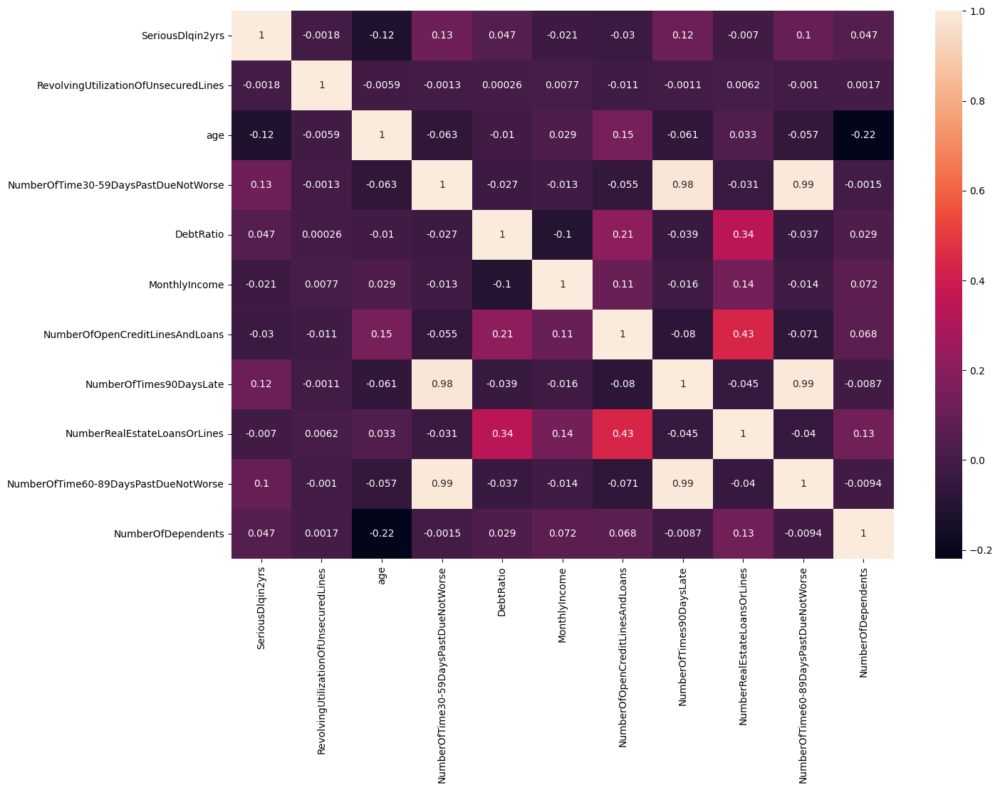

In [159]:
plt.figure(figsize=(15,10))
sns.heatmap(df_imputed_using_iterativeimputer.corr(),annot=True)
plt.show()

#### comments:
- None of the column has high linear corealation with the target column.
- The high correlation between NumberOfTime30-59DaysPastDueNotWorse,NumberOfTime60-89DaysPastDueNotWorse and NumberOfTimes90DaysLate shows that if a person is late by more than 30 days there is a high probability that he might be late in payments by more than90 days. 
- we can keep one colun and drop other highly correlated columns 
- or we can use other techniques to confirm it 

In [42]:
# Finding all those columns who has correlation >0.75 and printing the details of the same
import pandas as pd

# Assuming 'df' is your dataframe
correlation_matrix = df_imputed_using_iterativeimputer.corr()

# Finding columns with correlation > 0.75
high_correlation_cols = []
for col in correlation_matrix.columns:
    correlated_cols = correlation_matrix[correlation_matrix[col] > 0.75].index.tolist()
    correlated_cols.remove(col)
    if correlated_cols:
        high_correlation_cols.append((col, correlated_cols))

# Printing columns with correlation > 0.75
if high_correlation_cols:
    print("Columns with correlation > 0.75:")
    for col, correlated_cols in high_correlation_cols:
        print(f"{col} is highly correlated with: {', '.join(correlated_cols)}")
else:
    print("No columns have correlation > 0.75")


Columns with correlation > 0.75:
NumberOfTime30-59DaysPastDueNotWorse is highly correlated with: NumberOfTimes90DaysLate, NumberOfTime60-89DaysPastDueNotWorse
NumberOfTimes90DaysLate is highly correlated with: NumberOfTime30-59DaysPastDueNotWorse, NumberOfTime60-89DaysPastDueNotWorse
NumberOfTime60-89DaysPastDueNotWorse is highly correlated with: NumberOfTime30-59DaysPastDueNotWorse, NumberOfTimes90DaysLate


In [43]:
#Using Eigen value and condition number to check multi-collinearity.

correlation_matrix = df_imputed_using_iterativeimputer.corr()

eigenvalues, _ = np.linalg.eig(correlation_matrix)

condition_number = max(eigenvalues) / min(eigenvalues)

print("Eigenvalues of the correlation matrix:")
print(eigenvalues)
print("Condition Number:")
print(condition_number)


Eigenvalues of the correlation matrix:
[3.020216   1.70152867 0.00664607 0.01707358 1.27194929 0.51589209
 1.11729282 0.92929065 1.00019135 0.76030584 0.65961365]
Condition Number:
454.43641015530807


Comment:
- the eigenvalues and condition number indicates multicollinearity. The relatively large condition number indicates that the correlation matrix is sensitive to small changes, which can lead to instability in regression models.
- eigenvalues close to zero indicate high multicollinearity whereas larger eigenvalues suggest that the corresponding variables have more unique information and less multicollinearity.

High Multi-collinearity exists.

In [64]:
df_imputed_using_iterativeimputer.columns

Index(['SeriousDlqin2yrs', 'RevolvingUtilizationOfUnsecuredLines', 'age',
       'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio', 'MonthlyIncome',
       'NumberOfOpenCreditLinesAndLoans', 'NumberOfTimes90DaysLate',
       'NumberRealEstateLoansOrLines', 'NumberOfTime60-89DaysPastDueNotWorse',
       'NumberOfDependents'],
      dtype='object')

In [65]:
# Feature correlation with the target column
df_imputed_using_iterativeimputer.corr()['SeriousDlqin2yrs'].reset_index()

,index,SeriousDlqin2yrs
0,SeriousDlqin2yrs,1.000000
1,RevolvingUtilizationOfUnsecuredLines,-0.001802
2,age,-0.115386
3,NumberOfTime30-59DaysPastDueNotWorse,0.125587
4,DebtRatio,0.047426
5,MonthlyIncome,-0.021274
6,NumberOfOpenCreditLinesAndLoans,-0.029669
7,NumberOfTimes90DaysLate,0.117175
8,NumberRealEstateLoansOrLines,-0.007038
9,NumberOfTime60-89DaysPastDueNotWorse,0.102261


In [97]:
corr_values_or_importance = df_imputed_using_iterativeimputer.corr()['SeriousDlqin2yrs'].reset_index()
corr_values_or_importance.rename(columns= {'index':'Feature','SeriousDlqin2yrs':'importance_corr'},inplace=True)
corr_values_or_importance

,Feature,importance_corr
0,SeriousDlqin2yrs,1.000000
1,RevolvingUtilizationOfUnsecuredLines,-0.001802
2,age,-0.115386
3,NumberOfTime30-59DaysPastDueNotWorse,0.125587
4,DebtRatio,0.047426
5,MonthlyIncome,-0.021274
6,NumberOfOpenCreditLinesAndLoans,-0.029669
7,NumberOfTimes90DaysLate,0.117175
8,NumberRealEstateLoansOrLines,-0.007038
9,NumberOfTime60-89DaysPastDueNotWorse,0.102261


**B. Feature importance using Random Forest.**

In [68]:
from sklearn.ensemble import RandomForestClassifier
X= df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y= df_imputed_using_iterativeimputer['SeriousDlqin2yrs']
rf_classifier = RandomForestClassifier(n_estimators=100, random_state=42)
rf_classifier.fit(X, y)

feature_importances = rf_classifier.feature_importances_

# Sort indices by importance in descending order
indices = np.argsort(feature_importances)[::-1]

# Print feature ranking
print("Feature ranking:")
for f in range(X.shape[1]):
    print(f"{f + 1}. Feature {indices[f]} ({feature_importances[indices[f]]})")


Feature ranking:
1. Feature 3 (0.18150068444041723)
2. Feature 0 (0.18147084359007465)
3. Feature 4 (0.1673290256472241)
4. Feature 1 (0.11845743458346754)
5. Feature 6 (0.09247047303592981)
6. Feature 5 (0.08787030668986903)
7. Feature 2 (0.04943861416834287)
8. Feature 8 (0.045974292281025404)
9. Feature 9 (0.04276312228922654)
10. Feature 7 (0.0327252032744228)


In [99]:
# Forming a dataframe out of this data:
feature_importances = rf_classifier.feature_importances_

# Create a DataFrame for feature ranking
feature_ranking_df_rf = pd.DataFrame({'Feature': X.columns,
                                   'importance_rf': feature_importances})

# Sort the DataFrame by importance in descending order
feature_ranking_df_rf = feature_ranking_df_rf.sort_values(by='importance_rf', ascending=False)

feature_ranking_df_rf

,Feature,importance_rf
3,DebtRatio,0.181501
0,RevolvingUtilizationOfUnsecuredLines,0.181471
4,MonthlyIncome,0.167329
1,age,0.118457
6,NumberOfTimes90DaysLate,0.092470
5,NumberOfOpenCreditLinesAndLoans,0.087870
2,NumberOfTime30-59DaysPastDueNotWorse,0.049439
8,NumberOfTime60-89DaysPastDueNotWorse,0.045974
9,NumberOfDependents,0.042763
7,NumberRealEstateLoansOrLines,0.032725


**C. Feature Importance using Gradient Boosting:**


In [ ]:
from sklearn.ensemble import GradientBoostingClassifier

X= df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y= df_imputed_using_iterativeimputer['SeriousDlqin2yrs']

clf = GradientBoostingClassifier()

clf.fit(X, y)

feature_importance = clf.feature_importances_

feature_df_gbc = pd.DataFrame({'Feature': X.columns, 'importance_gbc': feature_importance})

feature_df_gbc = feature_df_gbc.sort_values(by='importance', ascending=False)

feature_df_gbc


**D.Permutation Importance**

In [121]:
from sklearn.inspection import permutation_importance

X = df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y = df_imputed_using_iterativeimputer['SeriousDlqin2yrs']

from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25,stratify=y)

rf = RandomForestClassifier()

rf.fit(X_train, y_train)

result = permutation_importance(rf, X_test, y_test, n_repeats=30, random_state=0)

feature_importance_per = pd.DataFrame({'Feature': X.columns, 'importance_permutation': result.importances_mean})

feature_importance_per = feature_importance_per.sort_values(by='importance_permutation', ascending=False)


feature_importance_per


,Feature,importance_permutation
6,NumberOfTimes90DaysLate,0.005355
3,DebtRatio,0.004506
4,MonthlyIncome,0.001761
0,RevolvingUtilizationOfUnsecuredLines,0.001479
5,NumberOfOpenCreditLinesAndLoans,0.001172
8,NumberOfTime60-89DaysPastDueNotWorse,0.000441
2,NumberOfTime30-59DaysPastDueNotWorse,0.000353
9,NumberOfDependents,0.000212
7,NumberRealEstateLoansOrLines,0.000004
1,age,-0.000064


**E. Feature importance using ANOVA f value.**

In [163]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_classif

In [164]:
k = 5 
selector = SelectKBest(score_func=f_classif, k=k)
X = df_imputed_using_iterativeimputer
y = df1['SeriousDlqin2yrs']

In [165]:
selector.fit(X, y)

SelectKBest(k=5)

In [166]:
p_values = selector.pvalues_
selected_features_indices = selector.get_support(indices=True)

In [167]:
p_values

array([0.00000000e+00, 4.85356277e-01, 0.00000000e+00, 0.00000000e+00,
       1.97017245e-75, 1.72006269e-16, 1.43021002e-30, 0.00000000e+00,
       6.41338496e-03, 0.00000000e+00, 1.56076826e-74])

In [168]:
selected_features = X.columns[selected_features_indices]
selected_features

Index(['SeriousDlqin2yrs', 'age', 'NumberOfTime30-59DaysPastDueNotWorse',
       'NumberOfTimes90DaysLate', 'NumberOfTime60-89DaysPastDueNotWorse'],
      dtype='object')

**F. Feature importance using Mutual Information**

In [145]:
from sklearn.feature_selection import mutual_info_classif

X = df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y = df_imputed_using_iterativeimputer['SeriousDlqin2yrs']

mi_scores = mutual_info_classif(X, y)

mi_df = pd.DataFrame({'Feature': X.columns, 'importance_mif': mi_scores})

mi_df = mi_df.sort_values(by='importance_mif', ascending=False)

mi_df


,Feature,importance_mif
0,RevolvingUtilizationOfUnsecuredLines,0.036764
6,NumberOfTimes90DaysLate,0.032428
2,NumberOfTime30-59DaysPastDueNotWorse,0.027644
8,NumberOfTime60-89DaysPastDueNotWorse,0.022022
4,MonthlyIncome,0.011002
1,age,0.008361
3,DebtRatio,0.008290
7,NumberRealEstateLoansOrLines,0.006907
5,NumberOfOpenCreditLinesAndLoans,0.005072
9,NumberOfDependents,0.004199


#####  Exhaustive feature selection technique:

In [171]:
# Trying Exhaustive feature selection technique
# from mlxtend.feature_selection import ExhaustiveFeatureSelector as EFS

In [173]:
# from mlxtend.feature_selection import ExhaustiveFeatureSelector
# from sklearn.linear_model import LogisticRegression
# from sklearn.model_selection import train_test_split


# X = df_imputed_using_iterativeimputer
# y = df1['SeriousDlqin2yrs']

# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

# model = LogisticRegression()

# efs = ExhaustiveFeatureSelector(model,
#                                 min_features=1,
#                                 max_features=X.shape[1],
#                                 scoring='f1',
#                                 print_progress=True)

# efs = efs.fit(X_train, y_train)

# best_subset = X.columns[[efs.best_idx_]]
# best_score = efs.best_score_
# print("Best Subset:", best_subset)
# print("Best Score:", best_score)

**Since the dataset his huge in regards of number of data points using this technique would not be possible because of high computation.**

**D. Using RFE Technique**

In [176]:
from sklearn.preprocessing import RobustScaler
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestClassifier

model = RandomForestClassifier()

rfe = RFE(model, n_features_to_select=5) 
rs_rfe =RobustScaler() #although tree based algorithms are not much affected by the outliers but to be on safe side i have used this
X=rs_rfe.fit_transform(df_imputed_using_iterativeimputer)
y=df1['SeriousDlqin2yrs']
rfe.fit(X, y)

# Print the rankings of the features
feature_rankings = rfe.ranking_
selected_features = df_imputed_using_iterativeimputer.columns[rfe.support_]
for feature, rank in zip(selected_features, feature_rankings):
    print(f"Feature: {feature}, Rank: {rank}")

Feature: SeriousDlqin2yrs, Rank: 1
Feature: RevolvingUtilizationOfUnsecuredLines, Rank: 1
Feature: NumberOfTime30-59DaysPastDueNotWorse, Rank: 4
Feature: NumberOfTimes90DaysLate, Rank: 1
Feature: NumberOfTime60-89DaysPastDueNotWorse, Rank: 2


In [87]:
from sklearn.feature_selection import RFE

estimator = RandomForestClassifier()

selector_label = RFE(estimator, n_features_to_select=X.shape[1], step=1)
selector_label = selector_label.fit(X, y)

# Get the selected features based on RFE
selected_features = X.columns[selector_label.support_]

# Extract the coefficients for the selected features from the underlying linear regression model
selected_coefficients = selector_label.estimator_.feature_importances_



In [88]:
# Organize the results into a DataFrame
rfe_df6 = pd.DataFrame({
    'feature': selected_features,
    'rfe_score': selected_coefficients
}).sort_values(by='rfe_score', ascending=False)

rfe_df6

,feature,rfe_score
0,RevolvingUtilizationOfUnsecuredLines,0.182420
3,DebtRatio,0.181908
4,MonthlyIncome,0.166845
1,age,0.117628
6,NumberOfTimes90DaysLate,0.089789
5,NumberOfOpenCreditLinesAndLoans,0.087838
2,NumberOfTime30-59DaysPastDueNotWorse,0.051494
8,NumberOfTime60-89DaysPastDueNotWorse,0.046361
9,NumberOfDependents,0.042936
7,NumberRealEstateLoansOrLines,0.032781


In [91]:
rfe_df6.rename(columns={'feature':'Feature'},inplace=True)

In [59]:
#!pip install shap

                                              0.0/462.3 kB ? eta -:--:--
     --                                      30.7/462.3 kB 1.4 MB/s eta 0:00:01
     ----------                             122.9/462.3 kB 1.4 MB/s eta 0:00:01
     -------------------                    235.5/462.3 kB 2.1 MB/s eta 0:00:01
     -------------------------------------  460.8/462.3 kB 2.6 MB/s eta 0:00:01
     -------------------------------------  460.8/462.3 kB 2.6 MB/s eta 0:00:01
     -------------------------------------  460.8/462.3 kB 2.6 MB/s eta 0:00:01
     -------------------------------------  460.8/462.3 kB 2.6 MB/s eta 0:00:01
     -------------------------------------- 462.3/462.3 kB 1.4 MB/s eta 0:00:00
                                              0.0/2.6 MB ? eta -:--:--
     -------                                  0.5/2.6 MB 30.1 MB/s eta 0:00:01
     ---------------------                    1.4/2.6 MB 14.3 MB/s eta 0:00:01
     -------------------------                1.6/2.6 MB 1


[notice] A new release of pip is available: 23.1.2 -> 23.2.1
[notice] To update, run: python.exe -m pip install --upgrade pip


In [ ]:
import shap

X = df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y = df_imputed_using_iterativeimputer['SeriousDlqin2yrs']

# Initialize a Random Forest Classifier (you can use any estimator)
rf_model = RandomForestClassifier()
rf_model.fit(X, y)

# Initialize the SHAP explainer
explainer = shap.TreeExplainer(rf_model)

# Calculate SHAP values
shap_values = explainer.shap_values(X)

# Get feature importances from SHAP values
feature_importances = abs(shap_values).mean(axis=0)

# Create a DataFrame to store feature names and their SHAP importances
feature_shap_df = pd.DataFrame({'Feature': X.columns, 'SHAP_Importance': feature_importances})

# Sort the DataFrame by SHAP importances
feature_shap_df = feature_shap_df.sort_values(by='SHAP_Importance', ascending=False)

# Print the DataFrame
print(feature_shap_df)


In [146]:
#Merging dataframes on feature names so as to obtain the average feature importance 

merged_df = corr_values_or_importance

# List of dataframes to merge
dfs_to_merge = [feature_ranking_df_rf, feature_df_gbc, feature_importance_per, mi_df, rfe_df6]

# Merge the dataframes
for df in dfs_to_merge:
    merged_df = pd.merge(merged_df, df, on='Feature', how='outer')


merged_df


,Feature,importance_corr,importance_rf,importance_gbc,importance_permutation,importance_mif,rfe_score
0,SeriousDlqin2yrs,1.000000,NaN,NaN,NaN,NaN,NaN
1,RevolvingUtilizationOfUnsecuredLines,-0.001802,0.181471,0.158722,0.001479,0.036764,0.182420
2,age,-0.115386,0.118457,0.015025,-0.000064,0.008361,0.117628
3,NumberOfTime30-59DaysPastDueNotWorse,0.125587,0.049439,0.123227,0.000353,0.027644,0.051494
4,DebtRatio,0.047426,0.181501,0.056520,0.004506,0.008290,0.181908
5,MonthlyIncome,-0.021274,0.167329,0.023496,0.001761,0.011002,0.166845
6,NumberOfOpenCreditLinesAndLoans,-0.029669,0.087870,0.013348,0.001172,0.005072,0.087838
7,NumberOfTimes90DaysLate,0.117175,0.092470,0.480285,0.005355,0.032428,0.089789
8,NumberRealEstateLoansOrLines,-0.007038,0.032725,0.009718,0.000004,0.006907,0.032781
9,NumberOfTime60-89DaysPastDueNotWorse,0.102261,0.045974,0.117904,0.000441,0.022022,0.046361


In [147]:
merged_df_f=merged_df.iloc[1:,:] 
merged_df_f

,Feature,importance_corr,importance_rf,importance_gbc,importance_permutation,importance_mif,rfe_score
1,RevolvingUtilizationOfUnsecuredLines,-0.001802,0.181471,0.158722,0.001479,0.036764,0.182420
2,age,-0.115386,0.118457,0.015025,-0.000064,0.008361,0.117628
3,NumberOfTime30-59DaysPastDueNotWorse,0.125587,0.049439,0.123227,0.000353,0.027644,0.051494
4,DebtRatio,0.047426,0.181501,0.056520,0.004506,0.008290,0.181908
5,MonthlyIncome,-0.021274,0.167329,0.023496,0.001761,0.011002,0.166845
6,NumberOfOpenCreditLinesAndLoans,-0.029669,0.087870,0.013348,0.001172,0.005072,0.087838
7,NumberOfTimes90DaysLate,0.117175,0.092470,0.480285,0.005355,0.032428,0.089789
8,NumberRealEstateLoansOrLines,-0.007038,0.032725,0.009718,0.000004,0.006907,0.032781
9,NumberOfTime60-89DaysPastDueNotWorse,0.102261,0.045974,0.117904,0.000441,0.022022,0.046361
10,NumberOfDependents,0.047135,0.042763,0.001754,0.000212,0.004199,0.042936


In [148]:
merged_df_f.columns

Index(['Feature', 'importance_corr', 'importance_rf', 'importance_gbc',
       'importance_permutation', 'importance_mif', 'rfe_score'],
      dtype='object')

In [151]:
# normalizing the score before finding the average
col_list = ['importance_corr', 'importance_rf', 'importance_gbc',
       'importance_permutation', 'importance_mif', 'rfe_score']
for i in col_list:
    merged_df_f[i]= merged_df_f[i]/sum(merged_df_f[i])

In [152]:
merged_df_f

,Feature,importance_corr,importance_rf,importance_gbc,importance_permutation,importance_mif,rfe_score
1,RevolvingUtilizationOfUnsecuredLines,-0.006813,0.181471,0.158722,0.097191,0.225978,0.182420
2,age,-0.436379,0.118457,0.015025,-0.004205,0.051393,0.117628
3,NumberOfTime30-59DaysPastDueNotWorse,0.474960,0.049439,0.123227,0.023188,0.169916,0.051494
4,DebtRatio,0.179360,0.181501,0.056520,0.296069,0.050957,0.181908
5,MonthlyIncome,-0.080456,0.167329,0.023496,0.115706,0.067628,0.166845
6,NumberOfOpenCreditLinesAndLoans,-0.112204,0.087870,0.013348,0.077040,0.031178,0.087838
7,NumberOfTimes90DaysLate,0.443145,0.092470,0.480285,0.351849,0.199324,0.089789
8,NumberRealEstateLoansOrLines,-0.026618,0.032725,0.009718,0.000234,0.042454,0.032781
9,NumberOfTime60-89DaysPastDueNotWorse,0.386743,0.045974,0.117904,0.028970,0.135364,0.046361
10,NumberOfDependents,0.178262,0.042763,0.001754,0.013959,0.025808,0.042936


In [153]:
merged_df_f['Total_value']=merged_df_f.mean(axis=1)

In [154]:
# finding average feature importance:
merged_df_f.sort_values(ascending=False,by='Total_value')

,Feature,importance_corr,importance_rf,importance_gbc,importance_permutation,importance_mif,rfe_score,Total_value
7,NumberOfTimes90DaysLate,0.443145,0.092470,0.480285,0.351849,0.199324,0.089789,0.276144
4,DebtRatio,0.179360,0.181501,0.056520,0.296069,0.050957,0.181908,0.157719
3,NumberOfTime30-59DaysPastDueNotWorse,0.474960,0.049439,0.123227,0.023188,0.169916,0.051494,0.148704
1,RevolvingUtilizationOfUnsecuredLines,-0.006813,0.181471,0.158722,0.097191,0.225978,0.182420,0.139828
9,NumberOfTime60-89DaysPastDueNotWorse,0.386743,0.045974,0.117904,0.028970,0.135364,0.046361,0.126886
5,MonthlyIncome,-0.080456,0.167329,0.023496,0.115706,0.067628,0.166845,0.076758
10,NumberOfDependents,0.178262,0.042763,0.001754,0.013959,0.025808,0.042936,0.050914
6,NumberOfOpenCreditLinesAndLoans,-0.112204,0.087870,0.013348,0.077040,0.031178,0.087838,0.030845
8,NumberRealEstateLoansOrLines,-0.026618,0.032725,0.009718,0.000234,0.042454,0.032781,0.015216
2,age,-0.436379,0.118457,0.015025,-0.004205,0.051393,0.117628,-0.023014


**NumberOfTimes90DaysLate,NumberOfTime30-59DaysPastDueNotWorse and NumberOfTime60-89DaysPastDueNotWorse are highly multi-collinear**

**<mark>Creating a new Feature out of these 3 Features**</mark>

In [156]:
df_imputed_using_iterativeimputer.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents
0,1.0,0.766127,45.0,2.0,0.802982,9120.0,13.0,0.0,6.0,0.0,2.0
1,0.0,0.957151,40.0,0.0,0.121876,2600.0,4.0,0.0,0.0,0.0,1.0
2,0.0,0.658180,38.0,1.0,0.085113,3042.0,2.0,1.0,0.0,0.0,0.0
3,0.0,0.233810,30.0,0.0,0.036050,3300.0,5.0,0.0,0.0,0.0,0.0
4,0.0,0.907239,49.0,1.0,0.024926,63588.0,7.0,0.0,1.0,0.0,0.0


In [161]:
df_imputed_using_iterativeimputer['Number of Defaults in past'] = df_imputed_using_iterativeimputer['NumberOfTime30-59DaysPastDueNotWorse']+df_imputed_using_iterativeimputer['NumberOfTimes90DaysLate']+df_imputed_using_iterativeimputer['NumberOfTime60-89DaysPastDueNotWorse']

In [162]:
df_imputed_using_iterativeimputer.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,NumberOfTime30-59DaysPastDueNotWorse,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberOfTimes90DaysLate,NumberRealEstateLoansOrLines,NumberOfTime60-89DaysPastDueNotWorse,NumberOfDependents,Number of Defaults,Number of Defaults in past
0,1.0,0.766127,45.0,2.0,0.802982,9120.0,13.0,0.0,6.0,0.0,2.0,2.0,2.0
1,0.0,0.957151,40.0,0.0,0.121876,2600.0,4.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.658180,38.0,1.0,0.085113,3042.0,2.0,1.0,0.0,0.0,0.0,2.0,2.0
3,0.0,0.233810,30.0,0.0,0.036050,3300.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0
4,0.0,0.907239,49.0,1.0,0.024926,63588.0,7.0,0.0,1.0,0.0,0.0,1.0,1.0


In [163]:
df_imputed_using_iterativeimputer.columns

Index(['SeriousDlqin2yrs', 'RevolvingUtilizationOfUnsecuredLines', 'age',
       'NumberOfTime30-59DaysPastDueNotWorse', 'DebtRatio', 'MonthlyIncome',
       'NumberOfOpenCreditLinesAndLoans', 'NumberOfTimes90DaysLate',
       'NumberRealEstateLoansOrLines', 'NumberOfTime60-89DaysPastDueNotWorse',
       'NumberOfDependents', 'Number of Defaults',
       'Number of Defaults in past'],
      dtype='object')

In [165]:
df_imputed_using_iterativeimputer.drop(columns=['NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate','NumberOfTime60-89DaysPastDueNotWorse'],inplace=True)

In [166]:
df_imputed_using_iterativeimputer.head(3)

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
0,1.0,0.766127,45.0,0.802982,9120.0,13.0,6.0,2.0,2.0
1,0.0,0.957151,40.0,0.121876,2600.0,4.0,0.0,1.0,0.0
2,0.0,0.658180,38.0,0.085113,3042.0,2.0,0.0,0.0,2.0


**Finding the top features in the current df i.e df_imputed_using_iterativeimputer**

In [168]:
from sklearn.feature_selection import RFE
X= df_imputed_using_iterativeimputer.drop(columns='SeriousDlqin2yrs')
y= df_imputed_using_iterativeimputer['SeriousDlqin2yrs']
estimator = RandomForestClassifier()

selector_label = RFE(estimator, n_features_to_select=X.shape[1], step=1)
selector_label = selector_label.fit(X, y)

# Get the selected features based on RFE
selected_features = X.columns[selector_label.support_]

# Extract the coefficients for the selected features from the underlying linear regression model
selected_coefficients = selector_label.estimator_.feature_importances_

rfe_final= pd.DataFrame({
    'feature': selected_features,
    'rfe_score': selected_coefficients
}).sort_values(by='rfe_score', ascending=False)

rfe_final

,feature,rfe_score
0,RevolvingUtilizationOfUnsecuredLines,0.199076
2,DebtRatio,0.184931
3,MonthlyIncome,0.175748
7,Number of Defaults in past,0.148144
1,age,0.122855
4,NumberOfOpenCreditLinesAndLoans,0.092942
6,NumberOfDependents,0.043976
5,NumberRealEstateLoansOrLines,0.032328


**TOP FEATURES ARE:**

- **RevolvingUtilizationOfUnsecuredLines**
- **Debt Ratio**
- **Monthly Income**
- **Number of Defaults in past**

## MODEL BUILDING

**<mark>In order to prevent Data Leakage we would split the data into train test and then will impute the train data and test data separately.</mark>**  

#### Since the dataset is very huge we will be trying trying different techniques to obtain the best model :
- First we will try undersampling technique to reduce the the majority class i.e we will do random sampling of majority and combine that with minority class in a certain proportion. Another way would be to upsample the minority class. 
- using metrics like precision, recall, F1-score, or area under the precision-recall curve (AUPRC) if using the entire dataset without oversampling/undersampling technique along with out-of-core techniques like partial fit.
- Using algorithms which have internal hyper parameter like 'class_weight' to control class imbalance like Random Forest directly on the entire dataset.


In [170]:
import plotly.express as px
from sklearn.decomposition import PCA

In [171]:
X = df_imputed_using_iterativeimputer.drop('SeriousDlqin2yrs', axis=1)
y = df_imputed_using_iterativeimputer['SeriousDlqin2yrs']

In [172]:
from sklearn.preprocessing import RobustScaler
rb=RobustScaler()
X_scaled= rb.fit_transform(X)

In [173]:
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled)

In [174]:
pca_df = pd.DataFrame(data=X_pca, columns=['PC1', 'PC2', 'PC3'])
pca_df['target'] = y

In [175]:
fig = px.scatter_3d(pca_df, x='PC1', y='PC2', z='PC3', color='target',
                    title='PCA Visualization in 3D')
fig.show()

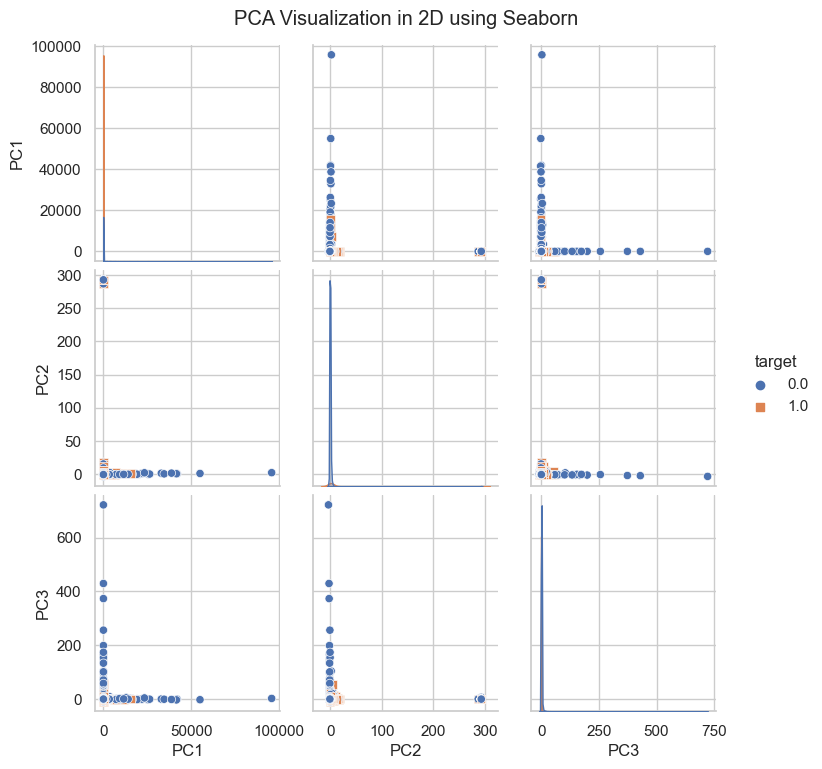

In [176]:
sns.set(style='whitegrid')

# Plotting in 2D using Seaborn for each pair of principal components
sns.pairplot(data=pca_df, hue='target', markers=['o', 's'], diag_kind='kde')
plt.suptitle('PCA Visualization in 2D using Seaborn', y=1.02)
plt.show()

**Comment: Since the data is not linearly separable hence algorithm like Logistic regression, vanilla SVC (SVC with kernel as rbf will work) will not perform well as they assume that the data is linearly separable.**

### Approach 1A. Manual Undersampling of Majority class so as to form a new dataframe to train the model and working with entire dataset without removal of outliers

Reeasons of doing the same:
- The classess will become balanced and hence the prediction will improve.
- Since data is randomly selected for training and testing the number of outliers might reduce or might increase in this partulcar dataset. So the model may become biased and may not gove right result.In order to tackle this 5/10 new dataframe can be formed form existing data frame so as to form a robust model.
- The underlying pattern the newly formed model will differ from the actual one hence the dataframe thus formed can only be used for prediction purposes but in case the probability of data points in the model need to be used for further work this will not help.

In [177]:
df3 =df1.copy()

In [178]:
df3.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 150000 entries, 0 to 149999
Data columns (total 11 columns):
 #   Column                                Non-Null Count   Dtype  
---  ------                                --------------   -----  
 0   SeriousDlqin2yrs                      150000 non-null  int64  
 1   RevolvingUtilizationOfUnsecuredLines  150000 non-null  float64
 2   age                                   150000 non-null  int64  
 3   NumberOfTime30-59DaysPastDueNotWorse  150000 non-null  int64  
 4   DebtRatio                             150000 non-null  float64
 5   MonthlyIncome                         120269 non-null  float64
 6   NumberOfOpenCreditLinesAndLoans       150000 non-null  int64  
 7   NumberOfTimes90DaysLate               150000 non-null  int64  
 8   NumberRealEstateLoansOrLines          150000 non-null  int64  
 9   NumberOfTime60-89DaysPastDueNotWorse  150000 non-null  int64  
 10  NumberOfDependents                    146076 non-null  float64
dtype

In [179]:
df3['Number of Defaults in past'] = df3['NumberOfTime30-59DaysPastDueNotWorse']+df3['NumberOfTimes90DaysLate']+df3['NumberOfTime60-89DaysPastDueNotWorse']

In [180]:
df3.drop(columns=['NumberOfTime30-59DaysPastDueNotWorse','NumberOfTimes90DaysLate','NumberOfTime60-89DaysPastDueNotWorse'],inplace=True)

In [181]:
df3.head()

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
0,1,0.766127,45,0.802982,9120.0,13,6,2.0,2
1,0,0.957151,40,0.121876,2600.0,4,0,1.0,0
2,0,0.658180,38,0.085113,3042.0,2,0,0.0,2
3,0,0.233810,30,0.036050,3300.0,5,0,0.0,0
4,0,0.907239,49,0.024926,63588.0,7,1,0.0,1


<mark>**Imputing train and test values separately so as to prevent data leakage**</mark>

In [182]:
X = df3.drop(columns='SeriousDlqin2yrs')
y = df3['SeriousDlqin2yrs']
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test= train_test_split(X,y,test_size=0.20,stratify=y,random_state=5)

In [183]:
y_train.value_counts()/y_train.value_counts().sum()

0    0.933158
1    0.066842
Name: SeriousDlqin2yrs, dtype: float64

In [184]:
# using iterative imputer to fill up the values
from fancyimpute import IterativeImputer


# Perform Multiple Imputation using MICE
imputer = IterativeImputer(max_iter=20, random_state=0)

# Fit and transform the DataFrame to impute missing values
X_train_transform = imputer.fit_transform(X_train)
X_test_transform= imputer.fit_transform(X_test)

# Convert the imputed data back to a DataFrame
X_train_imputed = pd.DataFrame(X_train_transform, columns=X_train.columns)
X_test_imputed = pd.DataFrame(X_test_transform, columns=X_test.columns)


In [185]:
X_train_imputed.reset_index(drop=True, inplace=True)
y_train.reset_index(drop=True, inplace=True)

In [186]:
training_data= pd.concat([X_train_imputed, y_train], axis=1)
training_data

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past,SeriousDlqin2yrs
0,0.749027,73.0,1.068589,4300.000000,12.0,2.0,0.0,0.0,0
1,0.015299,52.0,0.192324,21000.000000,19.0,1.0,3.0,0.0,0
2,0.923132,49.0,0.301225,12000.000000,8.0,1.0,5.0,0.0,0
3,0.323106,35.0,0.107054,6846.000000,4.0,0.0,0.0,1.0,0
4,1.000000,23.0,0.000000,2860.120388,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
119995,0.949519,43.0,0.231468,3520.000000,10.0,0.0,1.0,0.0,0
119996,0.455848,43.0,0.961134,3807.000000,5.0,1.0,1.0,0.0,0
119997,0.000000,42.0,0.064652,4500.000000,8.0,0.0,3.0,0.0,0
119998,0.054099,34.0,0.370148,11000.000000,9.0,2.0,1.0,0.0,0


In [187]:
training_data

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past,SeriousDlqin2yrs
0,0.749027,73.0,1.068589,4300.000000,12.0,2.0,0.0,0.0,0
1,0.015299,52.0,0.192324,21000.000000,19.0,1.0,3.0,0.0,0
2,0.923132,49.0,0.301225,12000.000000,8.0,1.0,5.0,0.0,0
3,0.323106,35.0,0.107054,6846.000000,4.0,0.0,0.0,1.0,0
4,1.000000,23.0,0.000000,2860.120388,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
119995,0.949519,43.0,0.231468,3520.000000,10.0,0.0,1.0,0.0,0
119996,0.455848,43.0,0.961134,3807.000000,5.0,1.0,1.0,0.0,0
119997,0.000000,42.0,0.064652,4500.000000,8.0,0.0,3.0,0.0,0
119998,0.054099,34.0,0.370148,11000.000000,9.0,2.0,1.0,0.0,0


In [188]:
majority_class = training_data[training_data['SeriousDlqin2yrs']==0].sample(30000)

In [189]:
minority_class= training_data[training_data['SeriousDlqin2yrs']==1]

In [190]:
df_for_model_building = pd.concat([majority_class,minority_class],axis=0)

In [191]:
print(df_for_model_building.shape)
df_for_model_building.sample(5)

(38021, 9)


,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past,SeriousDlqin2yrs
75108,0.000000,58.0,0.451198,6300.0,15.0,2.0,0.0,0.0,0
76030,0.046774,51.0,1.036991,2432.0,7.0,2.0,3.0,0.0,0
48131,0.000000,41.0,3.043956,1000.0,10.0,1.0,2.0,0.0,0
16417,0.073014,80.0,0.007047,10500.0,10.0,0.0,0.0,0.0,0
65436,0.688454,39.0,0.640533,7652.0,10.0,2.0,2.0,0.0,0


In [192]:
#Splitting the new data formed so as to use the test dataset for hyperparameter tuning and also as a validation set.
X = df_for_model_building.drop(columns='SeriousDlqin2yrs')
y = df_for_model_building['SeriousDlqin2yrs']
X_train_model_building, X_test_model_building, y_train_model_building, y_test_model_building= train_test_split(X,y,test_size=0.20,stratify=y)

In [193]:
from sklearn.preprocessing import RobustScaler
rb_scaler =RobustScaler()
X_train_model_building_scaled = rb_scaler.fit_transform(X_train_model_building)
X_test_model_building_scaled = rb_scaler.fit_transform(X_test_model_building)

#### <mark>Finding optimum value of parameters for better perfomance.</mark>

**a. For Random Forest Classifier:**

**The new dataframe formed has majority class: minority class in proportion 75:25 so we cant rely on accuracy alone we need to include recall also as a metric of evaluation**

In [195]:
from sklearn.metrics import recall_score, accuracy_score
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
from bayes_opt import BayesianOptimization

# Defining the custom scoring function
def custom_scorer(estimator, X, y):
    y_pred = estimator.predict(X)
    recall = recall_score(y, y_pred)
    accuracy = accuracy_score(y, y_pred)
    return 0.5 * recall + 0.5 * accuracy

def rf_objective(n_estimators, max_depth, min_samples_split, min_impurity_decrease):
    # Convert hyperparameters to integer or discrete values if necessary
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    min_samples_split = int(min_samples_split)
    min_impurity_decrease = int(min_impurity_decrease)
    
    rf = RandomForestClassifier(n_estimators=n_estimators, 
                                min_impurity_decrease=min_impurity_decrease,
                                max_depth=max_depth, 
                                min_samples_split=min_samples_split,
                                criterion='gini', 
                                max_features='sqrt')
    
    scores = cross_val_score(rf, X_train_model_building_scaled, y_train_model_building, cv=3, scoring=custom_scorer)
    return scores.mean()

param_bounds = {'n_estimators': (10, 200),
                'max_depth': (8, 32),
                'min_samples_split': (2, 15),
                'min_impurity_decrease': (0.01, 0.1)}

# Performing Bayesian optimization
optimizer = BayesianOptimization(f=rf_objective, pbounds=param_bounds)
optimizer.maximize(n_iter=10, init_points=5)


best_params = optimizer.max['params']
best_score = optimizer.max['target']
print("Best Hyperparameters:", best_params)
print("Best Score:", best_score)


|   iter    |  target   | max_depth | min_im... | min_sa... | n_esti... |
-------------------------------------------------------------------------
| 1         | 0.6577    | 8.593     | 0.01159   | 8.942     | 194.4     |
| 2         | 0.665     | 31.13     | 0.04542   | 13.64     | 23.92     |
| 3         | 0.6645    | 26.53     | 0.03919   | 14.32     | 44.6      |
| 4         | 0.6628    | 17.58     | 0.08573   | 7.528     | 56.39     |
| 5         | 0.6636    | 24.98     | 0.05779   | 10.51     | 63.07     |
| 6         | 0.6663    | 29.8      | 0.03176   | 13.46     | 23.41     |
| 7         | 0.6636    | 25.07     | 0.09161   | 13.5      | 22.24     |
| 8         | 0.6634    | 29.2      | 0.04917   | 11.57     | 20.25     |
| 9         | 0.6642    | 26.98     | 0.02649   | 14.58     | 25.56     |
| 10        | 0.6635    | 27.49     | 0.01838   | 10.1      | 25.47     |
| 11        | 0.6622    | 28.98     | 0.092     | 14.77     | 20.59     |
| 12        | 0.6665    | 30.27     | 

**b. For Gradient Boosting Algorithm**

In [196]:
from bayes_opt import BayesianOptimization
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import GradientBoostingClassifier

# Define the objective function for optimization
def rf_objective(n_estimators, max_depth, min_samples_split,min_impurity_decrease,learning_rate,min_samples_leaf):
    # Convert hyperparameters to integer or discrete values if necessary
    learning_rate=int(learning_rate)
    n_estimators = int(n_estimators)
    max_depth = int(max_depth)
    min_samples_split = int(min_samples_split)
    min_impurity_decrease= int(min_impurity_decrease)
    min_samples_leaf=int(min_samples_leaf)
    
    # Create the Random Forest classifier with the specified hyperparameters
    gb = GradientBoostingClassifier(n_estimators=n_estimators, learning_rate=learning_rate,min_impurity_decrease=min_impurity_decrease,
                                    max_depth=max_depth, 
                                    min_samples_split=min_samples_split,loss='log_loss',criterion='friedman_mse')
    
    # Perform cross-validation and return the mean accuracy score
    scores = cross_val_score(gb, X_train_model_building_scaled, y_train_model_building, cv=3,scoring =custom_scorer)
    return scores.mean()

# Define the hyperparameter search space

param_bounds = {'learning_rate': (0.001, 0.1),
                'n_estimators': (100,250),
                'max_depth': (2, 10),
                'min_samples_leaf':(1,20),
                'min_samples_split': (10, 100),
                'min_impurity_decrease':(0.001,0.1)}

# Perform Bayesian optimization
optimizer = BayesianOptimization(f=rf_objective, pbounds=param_bounds)
optimizer.maximize(n_iter=10, init_points=5)

# Get the best hyperparameters and the corresponding maximum validation score
best_params = optimizer.max['params']
best_score = optimizer.max['target']
print("Best Hyperparameters:", best_params)
print("Best Score:", best_score)

|   iter    |  target   | learni... | max_depth | min_im... | min_sa... | min_sa... | n_esti... |
-------------------------------------------------------------------------------------------------
| 1         | 0.3945    | 0.03983   | 3.243     | 0.05972   | 9.889     | 58.34     | 202.5     |
| 2         | 0.3945    | 0.007326  | 2.808     | 0.07065   | 13.5      | 77.14     | 233.3     |
| 3         | 0.3945    | 0.09818   | 9.503     | 0.02498   | 13.55     | 13.44     | 131.1     |
| 4         | 0.3945    | 0.06948   | 5.628     | 0.03064   | 11.95     | 32.43     | 155.8     |
| 5         | 0.3945    | 0.03886   | 5.371     | 0.07276   | 18.56     | 91.58     | 176.2     |
| 6         | 0.3945    | 0.04304   | 3.687     | 0.01946   | 2.453     | 99.38     | 100.1     |
| 7         | 0.3945    | 0.00732   | 4.494     | 0.08547   | 1.843     | 13.93     | 249.1     |
| 8         | 0.3945    | 0.02318   | 4.47      | 0.04723   | 17.61     | 11.79     | 100.6     |
| 9         | 0.3945

**Comment: The target value is same for all set of hyperparameter values, this implies that the gradient boosting is performing well with default hyperparameter values. 
Hence there is need to improve the scoring function in order to capture the changes in target variable and obtain right set of hyperparameter values.**

**<mark>'Validating the Above results as there is a chance that for the above hyperparameter values we may overfit'</mark>**

**For Random Forest**

In [216]:
from sklearn.ensemble import RandomForestClassifier
rfc = RandomForestClassifier()
criterion = ['gini', 'entropy', 'log_loss']
max_features = ['sqrt', 'log2', None]
grid = dict(criterion=criterion,max_features = max_features)
grid_search_rf = GridSearchCV(estimator=RandomForestClassifier(), param_grid=grid, cv=3, scoring='accuracy',n_jobs=-1)
grid_result_rf = grid_search_rf.fit(X_train_model_building_scaled, y_train_model_building)
print("Best: %f using %s" % (grid_result_rf.best_score_, grid_result_rf.best_params_))

Best: 0.844128 using {'criterion': 'log_loss', 'max_features': 'sqrt'}


Best Hyperparameters bayesian optimization:
: {'max_depth': 13.676532242773703, 'min_impurity_decrease': 0.022854848435148935, 'min_samples_split': 4.749256078827945, 'n_estimators': 130.73580621775915}
Best Score: 0.824317362184441

Max Acc obtained at n_estimators = 170, Accuracy = 0.8436554898093359


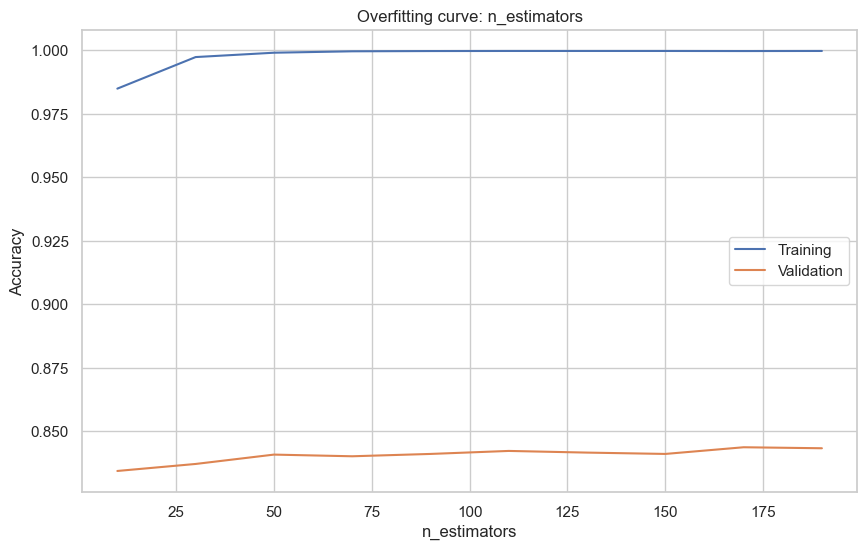

In [197]:
from sklearn.metrics import accuracy_score
def test_params(**params):
    model = RandomForestClassifier(random_state=42,criterion= 'log_loss', max_features= 'log2', **params)
    model.fit(X_train_model_building_scaled, y_train_model_building)
    train_score = accuracy_score(model.predict(X_train_model_building_scaled), y_train_model_building)
    val_score = accuracy_score(model.predict(X_test_model_building_scaled), y_test_model_building)
    return train_score, val_score

def test_param_and_plot(param_name, param_values):
    train_acc, val_acc = [], []
    best_param_value = None  
    max_val_acc = 0.0  
    for value in param_values:
        params = {param_name: value}
        train_score, val_score = test_params(**params)
        train_acc.append(train_score)
        val_acc.append(val_score)
        
        if val_score > max_val_acc:
            max_val_acc = val_score
            best_param_value = value
    
    plt.figure(figsize=(10, 6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_acc)
    plt.plot(param_values, val_acc)
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    print(f"Max Acc obtained at {param_name} = {best_param_value}, Accuracy = {max_val_acc}")
n_values = [10,30,50,70,90,110,130,150,170,190]
test_param_and_plot('n_estimators', n_values)


Max Acc obtained at max_depth = 4, Accuracy = 0.8489151873767259


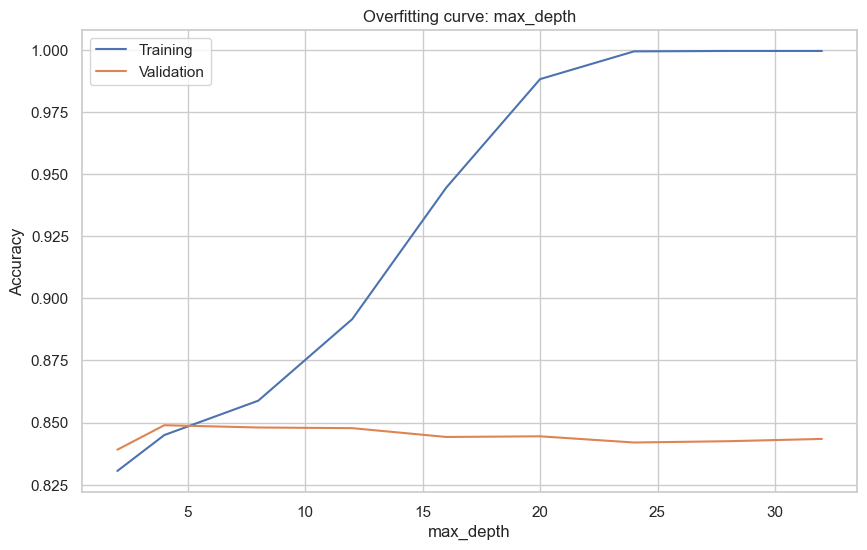

In [198]:
def test_params(**params):
    model = RandomForestClassifier(random_state=42,criterion= 'log_loss', max_features= 'log2', n_estimators= 190,**params)
    model.fit(X_train_model_building_scaled, y_train_model_building)
    train_score = accuracy_score(model.predict(X_train_model_building_scaled), y_train_model_building)
    val_score = accuracy_score(model.predict(X_test_model_building_scaled), y_test_model_building)
    return train_score, val_score

def test_param_and_plot(param_name, param_values):
    train_acc, val_acc = [], []
    best_param_value = None  
    max_val_acc = 0.0  
    for value in param_values:
        params = {param_name: value}
        train_score, val_score = test_params(**params)
        train_acc.append(train_score)
        val_acc.append(val_score)
        
        if val_score > max_val_acc:
            max_val_acc = val_score
            best_param_value = value
    
    plt.figure(figsize=(10, 6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_acc)
    plt.plot(param_values, val_acc)
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    print(f"Max Acc obtained at {param_name} = {best_param_value}, Accuracy = {max_val_acc}")
    
d_values = [2,4,8,12,16,20,24,28,32]
test_param_and_plot('max_depth', d_values)

Max Acc obtained at min_samples_split = 32, Accuracy = 0.8502301117685733


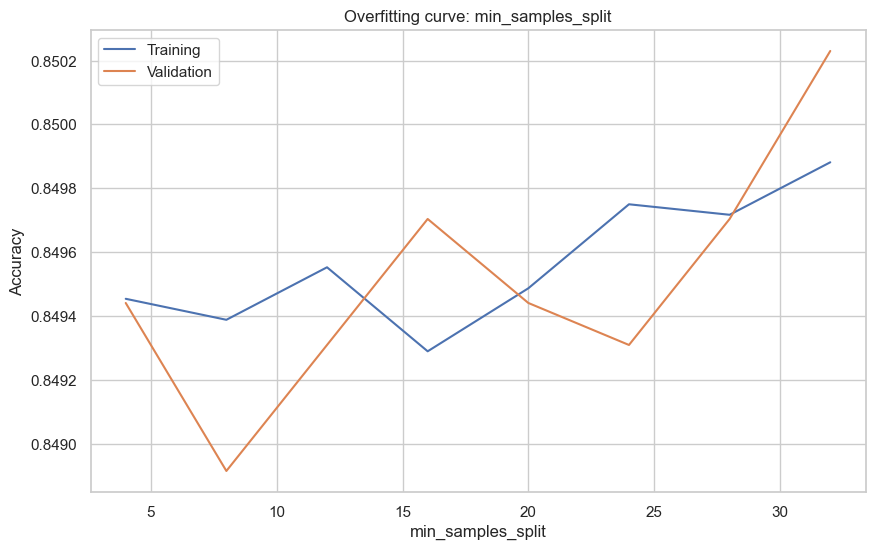

In [199]:
def test_params(**params):
    model = RandomForestClassifier(random_state=42,criterion= 'log_loss', max_features= 'log2',n_estimators=190,max_depth=5, **params)
    model.fit(X_train_model_building_scaled, y_train_model_building)
    train_score = accuracy_score(model.predict(X_train_model_building_scaled), y_train_model_building)
    val_score = accuracy_score(model.predict(X_test_model_building_scaled), y_test_model_building)
    return train_score, val_score

def test_param_and_plot(param_name, param_values):
    train_acc, val_acc = [], []
    best_param_value = None  
    max_val_acc = 0.0  
    for value in param_values:
        params = {param_name: value}
        train_score, val_score = test_params(**params)
        train_acc.append(train_score)
        val_acc.append(val_score)
        
        if val_score > max_val_acc:
            max_val_acc = val_score
            best_param_value = value
    
    plt.figure(figsize=(10, 6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_acc)
    plt.plot(param_values, val_acc)
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    print(f"Max Acc obtained at {param_name} = {best_param_value}, Accuracy = {max_val_acc}")


    
split_values = [4,8,12,16,20,24,28,32]
test_param_and_plot('min_samples_split', split_values)

Max Acc obtained at max_leaf_nodes = 29, Accuracy = 0.8498356344510191


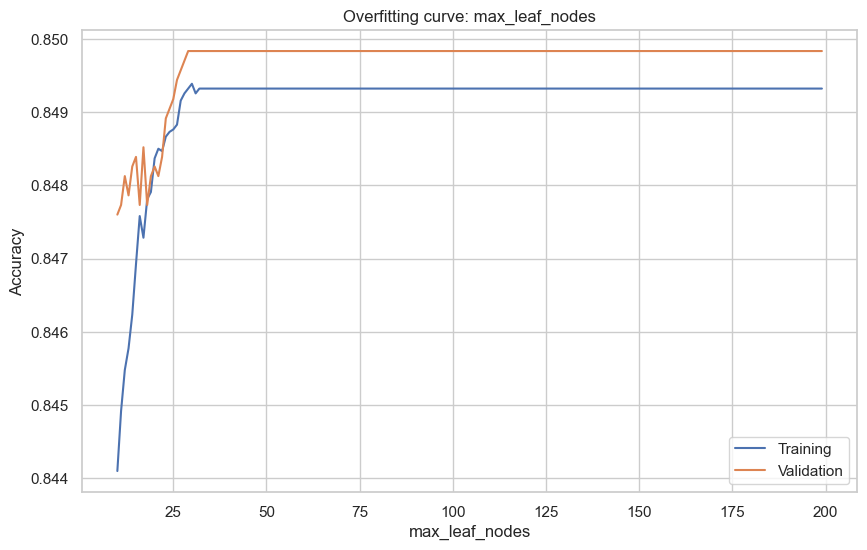

In [200]:
def test_params(**params):
    model = RandomForestClassifier(random_state=42,criterion= 'log_loss', max_features= 'log2',n_estimators=190,max_depth=5,min_samples_split=12, **params)
    model.fit(X_train_model_building_scaled, y_train_model_building)
    train_score = accuracy_score(model.predict(X_train_model_building_scaled), y_train_model_building)
    val_score = accuracy_score(model.predict(X_test_model_building_scaled), y_test_model_building)
    return train_score, val_score

def test_param_and_plot(param_name, param_values):
    train_acc, val_acc = [], []
    best_param_value = None  
    max_val_acc = 0.0  
    for value in param_values:
        params = {param_name: value}
        train_score, val_score = test_params(**params)
        train_acc.append(train_score)
        val_acc.append(val_score)
        
        if val_score > max_val_acc:
            max_val_acc = val_score
            best_param_value = value
    
    plt.figure(figsize=(10, 6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_acc)
    plt.plot(param_values, val_acc)
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    print(f"Max Acc obtained at {param_name} = {best_param_value}, Accuracy = {max_val_acc}")
max_leaf_nodes=[i for i in range(10,200)]
test_param_and_plot('max_leaf_nodes',max_leaf_nodes)

Max Acc obtained at min_impurity_decrease = 0.003, Accuracy = 0.8477317554240631


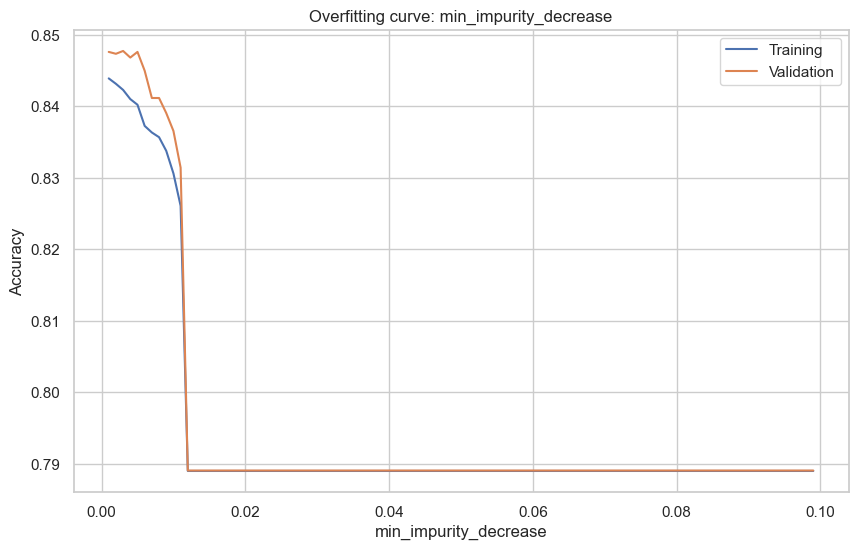

In [201]:
def test_params(**params):
    model = RandomForestClassifier(random_state=42,criterion= 'log_loss', max_features= 'log2',n_estimators=190,
                                   max_depth=5,min_samples_split=12, max_leaf_nodes=10,**params)
    model.fit(X_train_model_building_scaled, y_train_model_building)
    train_score = accuracy_score(model.predict(X_train_model_building_scaled), y_train_model_building)
    val_score = accuracy_score(model.predict(X_test_model_building_scaled), y_test_model_building)
    return train_score, val_score

def test_param_and_plot(param_name, param_values):
    train_acc, val_acc = [], []
    best_param_value = None  
    max_val_acc = 0.0  
    for value in param_values:
        params = {param_name: value}
        train_score, val_score = test_params(**params)
        train_acc.append(train_score)
        val_acc.append(val_score)
        
        if val_score > max_val_acc:
            max_val_acc = val_score
            best_param_value = value
    
    plt.figure(figsize=(10, 6))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_acc)
    plt.plot(param_values, val_acc)
    plt.xlabel(param_name)
    plt.ylabel('Accuracy')
    plt.legend(['Training', 'Validation'])
    print(f"Max Acc obtained at {param_name} = {best_param_value}, Accuracy = {max_val_acc}")
min_impurity_decrease=[i/1000 for i in range(1,100)]
test_param_and_plot('min_impurity_decrease',min_impurity_decrease)

In [202]:
#study shap

### ApproachB. Down samling the majority class data and forming multiple subsets combining  minority class data to each subset sample of majority class in equal proportions :

In [203]:
X_train_imputed

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
0,0.749027,73.0,1.068589,4300.000000,12.0,2.0,0.0,0.0
1,0.015299,52.0,0.192324,21000.000000,19.0,1.0,3.0,0.0
2,0.923132,49.0,0.301225,12000.000000,8.0,1.0,5.0,0.0
3,0.323106,35.0,0.107054,6846.000000,4.0,0.0,0.0,1.0
4,1.000000,23.0,0.000000,2860.120388,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...
119995,0.949519,43.0,0.231468,3520.000000,10.0,0.0,1.0,0.0
119996,0.455848,43.0,0.961134,3807.000000,5.0,1.0,1.0,0.0
119997,0.000000,42.0,0.064652,4500.000000,8.0,0.0,3.0,0.0
119998,0.054099,34.0,0.370148,11000.000000,9.0,2.0,1.0,0.0


In [204]:
X_train_imputed.reset_index(drop=True,inplace=True)
y_train.reset_index(drop=True,inplace=True)

In [205]:
df4= pd.concat([X_train_imputed,y_train],axis=1)
df4

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past,SeriousDlqin2yrs
0,0.749027,73.0,1.068589,4300.000000,12.0,2.0,0.0,0.0,0
1,0.015299,52.0,0.192324,21000.000000,19.0,1.0,3.0,0.0,0
2,0.923132,49.0,0.301225,12000.000000,8.0,1.0,5.0,0.0,0
3,0.323106,35.0,0.107054,6846.000000,4.0,0.0,0.0,1.0,0
4,1.000000,23.0,0.000000,2860.120388,0.0,0.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
119995,0.949519,43.0,0.231468,3520.000000,10.0,0.0,1.0,0.0,0
119996,0.455848,43.0,0.961134,3807.000000,5.0,1.0,1.0,0.0,0
119997,0.000000,42.0,0.064652,4500.000000,8.0,0.0,3.0,0.0,0
119998,0.054099,34.0,0.370148,11000.000000,9.0,2.0,1.0,0.0,0


In [206]:
df4.SeriousDlqin2yrs.value_counts()

0    111979
1      8021
Name: SeriousDlqin2yrs, dtype: int64

In [207]:
rb=RobustScaler()

In [208]:
# forming multiple datasets with different data from the majority class clubbed with the data from minrity class in eqaul proportion
data_size= df4.shape[0]
chunk_size = 20000
samples_4_training =[]
for i in range(0,data_size,10000):
    majority_class = df4[df4['SeriousDlqin2yrs']==0].iloc[i:i+10000]
    minority_class= df4[df4['SeriousDlqin2yrs']==1]
    df_for_upscaling_final = pd.concat([majority_class,minority_class])
    samples_4_training.append(df_for_upscaling_final)

In [209]:
samples_4_training[1]

,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past,SeriousDlqin2yrs
10723,0.081136,58.0,2090.000000,5096.296061,17.0,1.0,0.0,0.0,0
10724,0.130593,60.0,0.129500,10833.000000,4.0,1.0,2.0,0.0,0
10725,0.403530,48.0,2548.000000,7713.688439,12.0,2.0,4.0,0.0,0
10726,0.096440,75.0,1207.000000,5735.544873,9.0,1.0,0.0,0.0,0
10727,0.097392,55.0,0.461956,10500.000000,13.0,4.0,0.0,0.0,0
...,...,...,...,...,...,...,...,...,...
119963,0.989357,48.0,0.526689,6200.000000,15.0,2.0,2.0,0.0,1
119981,1.089701,46.0,0.214025,9582.000000,8.0,1.0,1.0,0.0,1
119982,0.542862,33.0,585.000000,3164.483206,5.0,0.0,0.0,0.0,1
119992,0.204505,39.0,0.207268,5200.000000,9.0,0.0,0.0,0.0,1


In [210]:
len(samples_4_training)

12

In [211]:
# USING Random Forest to train multiple models and then appending those models to a list:

from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
forest_models = []

for i in range(12):
    X_train=samples_4_training[i].drop(columns='SeriousDlqin2yrs')
    y_train=samples_4_training[i]['SeriousDlqin2yrs']
    
    forest_model = RandomForestClassifier(max_depth=8, min_samples_split= 13, min_impurity_decrease=0.001,
                                          n_estimators= 70,criterion='gini',max_leaf_nodes  =12,max_features='sqrt')
    X_train_scaled=rb.fit_transform(X_train)
    forest_model.fit(X_train_scaled, y_train)
    forest_models.append(forest_model)
    

In [215]:
len(forest_models)

12

In [212]:
#prediction
# each data point in X_test is given to the 12 models trained above and the mean core is calculated and if the mean is>0.6 we say 1
X_test_scaled=rb.fit_transform(X_test_imputed)
test_data = X_test_scaled
predictions = []

for forest_model in forest_models:
    chunk_predictions = forest_model.predict(test_data)
    predictions.append(chunk_predictions)

predictions_df = pd.DataFrame(predictions).T  

predictions_df['meanscore'] = predictions_df.mean(axis=1)
predictions_df['prediction_value'] = predictions_df['meanscore'].apply(lambda x: 1 if x > 0.6 else 0)

accuracy = accuracy_score(y_test, predictions_df['prediction_value'])
prec=precision_score(y_test, predictions_df['prediction_value'])
recl=recall_score(y_test, predictions_df['prediction_value'])
F1Score= f1_score(y_test, predictions_df['prediction_value'])
print("Accuracy:", accuracy)
print("precision:",prec)
print("Recall :",recl)
print("F1_Score:",F1Score)

Accuracy: 0.7513666666666666
precision: 0.1834958217270195
Recall : 0.7885286783042394
F1_Score: 0.29771207984182285


In [230]:
predictions_df['prediction_value1'] = predictions_df['meanscore'].apply(lambda x: 1 if x > 0.7 else 0)

accuracy = accuracy_score(y_test, predictions_df['prediction_value1'])
prec=precision_score(y_test, predictions_df['prediction_value1'])
recl=recall_score(y_test, predictions_df['prediction_value1'])
F1Score= f1_score(y_test, predictions_df['prediction_value1'])
print("Accuracy:", accuracy)
print("precision:",prec)
print("Recall :",recl)
print("F1_Score:",F1Score)

Accuracy: 0.7616
precision: 0.1879471322905299
Recall : 0.773067331670823
F1_Score: 0.3023800234100663


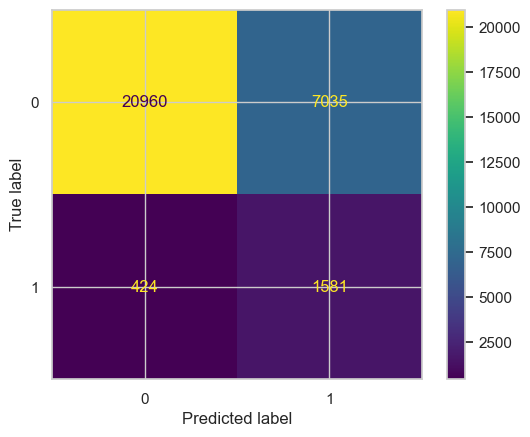

In [236]:
#confusion matrix using ConfusionMatrixDisplay 
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

matrix = confusion_matrix(y_test, predictions_df['prediction_value'])

disp = ConfusionMatrixDisplay(confusion_matrix=matrix)
disp.plot(cmap='viridis') 

plt.show()

Comment: as we increase the threshold value both accuracy and recall is decreasing

In [239]:
# Performing the same works as above Using Gradient Boosting
from sklearn.metrics import precision_score
from sklearn.metrics import recall_score
from sklearn.metrics import f1_score
gb_models = []

for i in range(12):
    X_train=samples_4_training[i].drop(columns='SeriousDlqin2yrs')
    y_train=samples_4_training[i]['SeriousDlqin2yrs']
    
    gb_model = GradientBoostingClassifier(learning_rate= 0.0027848193562057233, max_depth= 5, min_impurity_decrease= 0.06539892252080061, 
                                          min_samples_leaf= 14, min_samples_split= 57, n_estimators= 126)
    X_train_scaled=rb.fit_transform(X_train)
    gb_model.fit(X_train_scaled, y_train)
    gb_models.append(gb_model)
    


In [241]:
predictions_gb

[]

In [248]:
#prediction
# each data point in X_test is given to the 12 models trained above and the mean core is calculated and if the mean is>0.6 we say 1
X_test_scaled=rb.fit_transform(X_test_imputed)
test_data = X_test_scaled
predictions_gb = []

for forest_model in forest_models:
    chunk_predictions = forest_model.predict(test_data)
    predictions_gb.append(chunk_predictions)

predictions_df_gradientboosting = pd.DataFrame(predictions_gb).T  

predictions_df_gradientboosting['meanscore'] = predictions_df_gradientboosting.mean(axis=1)
predictions_df_gradientboosting['prediction_value'] = predictions_df_gradientboosting['meanscore'].apply(lambda x: 1 if x > 0.55 else 0)

accuracy = accuracy_score(y_test, predictions_df_gradientboosting['prediction_value'])
prec=precision_score(y_test, predictions_df_gradientboosting['prediction_value'])
recl=recall_score(y_test, predictions_df_gradientboosting['prediction_value'])
F1Score= f1_score(y_test, predictions_df_gradientboosting['prediction_value'])
print("Accuracy:", accuracy)
print("precision:",prec)
print("Recall :",recl)
print("F1_Score:",F1Score)

Accuracy: 0.8563333333333333
precision: 0.2660848386442054
Recall : 0.6538653366583541
F1_Score: 0.3782458165031737


**Comment: Although the recall has reduced but both accuracy and precision has increased significantly.**

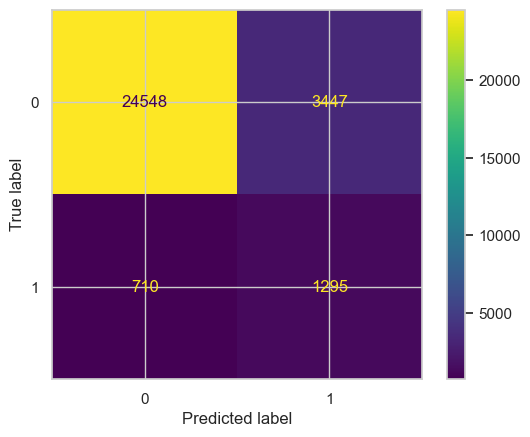

In [244]:
#confusion matrix using ConfusionMatrixDisplay 
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay, classification_report

matrix = confusion_matrix(y_test, predictions_df_gradientboosting['prediction_value'])

disp = ConfusionMatrixDisplay(confusion_matrix=matrix)
disp.plot(cmap='viridis') 

plt.show()


**C. Using Partial Fit SGD**

In [249]:
df1.SeriousDlqin2yrs.value_counts()

0    139974
1     10026
Name: SeriousDlqin2yrs, dtype: int64

In [250]:
#Upscaling the Minority class and combinig with the majority class

In [251]:

df_grouped=df3.groupby('SeriousDlqin2yrs')
df_grouped.get_group(1)

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
0,1,0.766127,45,0.802982,9120.0,13,6,2.0,2
13,1,0.964673,40,0.382965,13700.0,9,1,2.0,7
21,1,0.025656,38,0.475841,3000.0,7,1,2.0,0
25,1,0.392248,50,1.595253,4676.0,14,3,1.0,0
51,1,0.728150,31,0.824725,3000.0,10,2,1.0,0
...,...,...,...,...,...,...,...,...,...
149954,1,1.000000,46,170.398010,401.0,3,0,2.0,2
149955,1,1.135552,41,0.845887,7500.0,12,4,0.0,3
149961,1,0.920107,31,0.176732,1125.0,4,0,0.0,2
149968,1,0.983825,55,0.064116,4600.0,2,0,6.0,1


In [252]:
from sklearn.utils import resample
min_class_upsampled = resample(df_grouped.get_group(1), replace=True, n_samples=df_grouped.get_group(0).shape[0], random_state=0)

In [253]:
maj_class=df_grouped.get_group(0)

In [254]:
df_upscaled_combined=pd.concat([min_class_upsampled,maj_class])
df_upscaled_combined

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
41191,1,0.308018,57,0.175509,13759.0,9,2,1.0,0
147555,1,1.002920,52,0.264631,2750.0,6,0,0.0,0
49003,1,0.704091,70,0.009995,2100.0,3,0,0.0,4
72615,1,0.551206,62,1.053069,6500.0,16,2,3.0,0
138710,1,0.891016,25,1.621285,1446.0,6,1,0.0,1
...,...,...,...,...,...,...,...,...,...
149995,0,0.040674,74,0.225131,2100.0,4,1,0.0,0
149996,0,0.299745,44,0.716562,5584.0,4,1,2.0,0
149997,0,0.246044,58,3870.000000,NaN,18,1,0.0,0
149998,0,0.000000,30,0.000000,5716.0,4,0,0.0,0


In [255]:
shuffled_df = df_upscaled_combined.sample(frac=1, random_state=42).reset_index(drop=True)

In [256]:
shuffled_df

,SeriousDlqin2yrs,RevolvingUtilizationOfUnsecuredLines,age,DebtRatio,MonthlyIncome,NumberOfOpenCreditLinesAndLoans,NumberRealEstateLoansOrLines,NumberOfDependents,Number of Defaults in past
0,1,0.304242,69,0.163043,5703.0,6,0,1.0,1
1,0,1.000000,31,54.000000,NaN,0,0,0.0,0
2,1,1.003333,42,0.261999,11125.0,12,2,4.0,0
3,0,0.158300,59,0.100153,2615.0,7,0,0.0,0
4,0,0.101187,35,0.579504,5766.0,13,1,0.0,0
...,...,...,...,...,...,...,...,...,...
279943,1,0.960159,49,0.163450,4300.0,4,0,0.0,3
279944,0,0.758327,46,0.522033,4583.0,12,0,3.0,0
279945,1,1.044420,57,0.043044,1300.0,1,0,0.0,2
279946,0,0.000000,30,0.165205,4333.0,6,0,0.0,0


In [257]:
X = shuffled_df.drop(columns='SeriousDlqin2yrs')
y = shuffled_df['SeriousDlqin2yrs']
X_train_sgd, X_test_sgd, y_train_sgd, y_test_sgd= train_test_split(X,y,test_size=0.20,stratify=y)

In [258]:
# using iterative imputer to fill up the values
from fancyimpute import IterativeImputer


# Perform Multiple Imputation using MICE
imputer = IterativeImputer(max_iter=20, random_state=0)

# Fit and transform the DataFrame to impute missing values
X_train_transform = imputer.fit_transform(X_train_sgd)
X_test_transform= imputer.fit_transform(X_test_sgd)

# Convert the imputed data back to a DataFrame
X_train_imputed_sgd = pd.DataFrame(X_train_transform, columns=X_train.columns)
X_test_imputed_sgd = pd.DataFrame(X_test_transform, columns=X_test.columns)


In [259]:
shuffled_df.shape[0]

279948

In [260]:
from sklearn.linear_model import SGDClassifier

sgd_classifier = SGDClassifier(loss='log')

chunk_size = 20000
total_rows = shuffled_df.shape[0]

rb_sgd = RobustScaler()
X_train_scale_sgd = rb_sgd.fit_transform(X_train_imputed_sgd)
X_test_scaled_sgd = rb_sgd.transform(X_test_imputed_sgd)

for i in range(0, total_rows, chunk_size):
    chunk_data = X_train_scale_sgd[i:i+chunk_size]
    chunk_labels = y_train_sgd[i:i+chunk_size]
    if chunk_data.shape[0] > 0:  
        sgd_classifier.partial_fit(chunk_data, chunk_labels, classes=np.unique(y_train_sgd))

predictions = sgd_classifier.predict(X_test_scaled_sgd)

accuracy = accuracy_score(y_test_sgd, predictions)
precision = precision_score(y_test_sgd, predictions)
recall = recall_score(y_test_sgd, predictions)
f1 = f1_score(y_test_sgd, predictions)

print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1 Score:", f1)


Accuracy: 0.6987676370780497
Precision: 0.7609133961644863
Recall: 0.5796749419539203
F1 Score: 0.6580430639471231


In [252]:
# Naive Bayes Algorithm
# from sklearn.naive_bayes import MultinomialNB

# nb = MultinomialNB()

# chunk_size = 10000
# total_rows = X_train_comp.shape[0]

# for i in range(0, total_rows, chunk_size):
#     chunk_data = X_train_comp[i:i+chunk_size]
#     chunk_labels = y_train_comp[i:i+chunk_size]
    
#     nb.partial_fit(chunk_data, chunk_labels, classes=np.unique(y_train_comp))

# predictions = nb.predict(X_test_comp)

# accuracy = accuracy_score(y_test_comp, predictions)
# print("Accuracy:", accuracy)

Comment:
- multinomial naive bayes not applicable as our dataset has negative values(Debtratio feature). it is designed for features that represent count or frequency-like values, which are typically non-negative
- Also Naive bayes algorithm  is not suited for those datasets which have a mix of continuous and categorical features.  
- Bernouli cannot be applied as it is used when values in data is binary in nature.

**FINAL VERDICT: Based on above we can say gradient boosting with multiple instances is giving us the best result.**

## <mark> OTHER APPROACHES:</mark>
- **The above can be repeated with Outliers replaced by upper bound value which we can caluclate using 5 point summary.**
- **Completely removing the outliers**
- We could create a new categorical feature with value 0 for available data and 1 for missing data which would help us to tackle the issue of data missing data not at random after imputation.
- **<mark>Training model on entire dataset and then weighted sum of recall_score and precision could be used where recall is given more importance.</mark>**
- **Xgboost and other powerful algorithms can be used.**

## Dear kanth/Shubham 
## Please provide your comments on what extra I could have done?